In [109]:
# Load packages and set options

import sys
import os
import importlib

import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import skimage
import pywt
import sklearn
import cv2

from mpl_toolkits.mplot3d.axes3d import Axes3D
from skimage import feature,filters

import imageTools
import color
import texture
import image
import classifier
importlib.reload(imageTools)
importlib.reload(color)
importlib.reload(texture)
importlib.reload(image)
importlib.reload(classifier)

from imageTools import *
from color import *
from texture import *
from image import *
from classifier import *

np.set_printoptions(precision=4,suppress=True)

plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'plasma'
plt.rcParams['figure.dpi'] = 100
plt.rcParams['axes.titlesize'] = 8

import traceback
import warnings

def warn_with_traceback(message,category,filename,lineno,file=None,line=None):
    log = file if hasattr(file,'write') else sys.stderr
    traceback.print_stack(file=log)
    log.write(warnings.formatwarning(message,category,filename,lineno,line))

#warnings.showwarning = warn_with_traceback
warnings.simplefilter('ignore')

In [110]:
# Initialize classifier

#group = "other"
group = "mine"

directories =  {"pos":"positive_"+group,"test":"test_"+group}

maxsize = 1000000
%time clf = Classifier(directories,maxsize=maxsize)
#%time clf = Classifier(directories,maxsize=maxsize,pos=pos,test=test)

print("Train: "+str(len(clf.pos)))
print("Positive test: "+str(len(clf.getPosTest())))
print("Negative test: "+str(len(clf.getNegTest())))
#pos = clf.pos; test = clf.test

Wall time: 5min 35s
Train: 12
Positive test: 119
Negative test: 78


Color...
Texture...
Wall time: 3min 30s
(array([ 2, 60, 75]), array([ 12, 250, 250]))


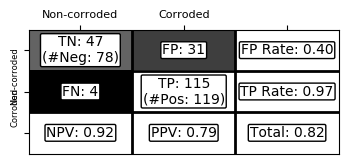

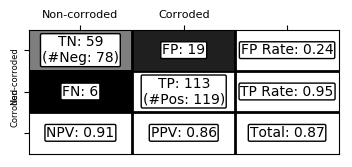

In [111]:
# Run classifier

blockThr = 0.9
hsThr = 0.18 # threshold for HS comparison
edgeThr = 0.2 # threshold for edge comparison
sig = 0.1 # sigma for smoothing in canny edge detector
HSBins = (180,256)

%time clf.run(blockThr=blockThr,hsThr=hsThr,edgeThr=edgeThr,sig=sig,HSBins=HSBins)
print(redRange())
plt.show()

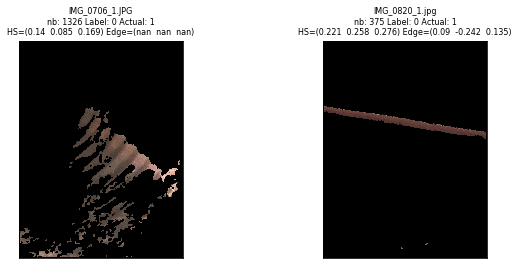

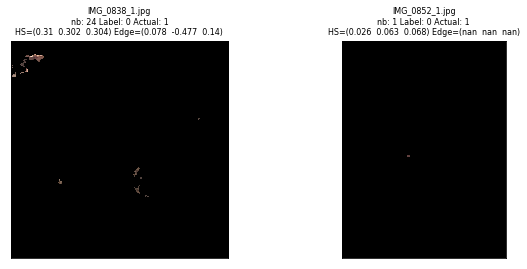

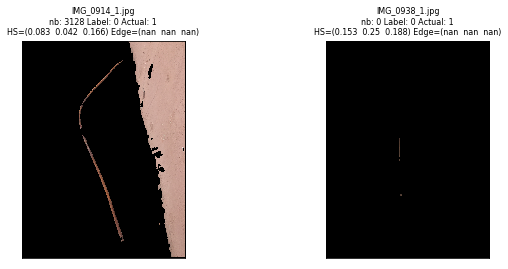

In [124]:
# Display selected results

#group = clf.pos
group = [im for im in clf.getFalse() if im.actual == 1]
#group = [im for im in clf.getFalse() if im.actual == 0]

#imgs = [im.rgb for im in group]
#imgs = [im.edgeMap for im in group]
#imgs = [getMasked(im.edgeMap,im.mask) for im in group]
imgs = [im.masked for im in group]
titles = [im.title for im in group]

"""
toStack1 = [imgs[1],imgs[-2],imgs[-3],imgs[9]]
toStack2 = [ed[1],ed[-2],ed[-3],ed[9]]
stacked1 = stack4(toStack1,method="long")
stacked2 = stack4(toStack2,method="long")
stacked = np.concatenate((stacked1,stacked2))
plt.figure(figsize=(20,10))
plt.imshow(stacked)
plt.xticks([]); plt.yticks([])
plt.savefig('../figures/'+'fp.png',bbox_inches='tight')
"""

displayAll(imgs,titles=titles)

plt.show()

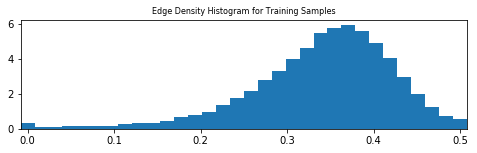

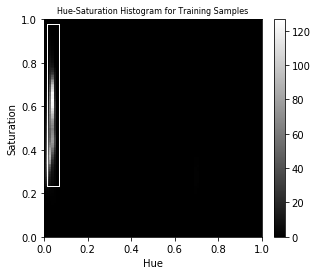

In [118]:
# Training results

%matplotlib inline

for im in clf.pos:
    im.setHSHist(nbins=(90,128))
    
clf.setPosHSHist()

nbins = 32
low = 0; high = 0.5
cen = np.linspace(low,high,nbins)
wid = cen[1]-cen[0]
histPlot(clf.posEdgeHist,cen,wid,title="Edge Density Histogram for Training Samples")
histPlot2d(clf.posHSHist,np.linspace(0,1,45),np.linspace(0,1,64),plt.figure(figsize=(12,4)),title="Hue-Saturation Histogram for Training Samples")

#display(im.edges,im.edgeMap)
#fullHist(im.edgeness,nbins=nbins)

plt.show()

Using matplotlib backend: TkAgg


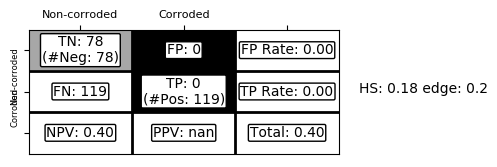

In [37]:
%matplotlib

def testClassifier(clf,hsThr,edgeThr,premethods=[2],postmethods=[2],show=True):
    clf.resetLabels()
    clf.preclassify(hsThr=hsThr,methods=premethods)
    clf.postclassify(edgeThr=edgeThr,methods=postmethods)
    clf.setConfMatrix()
    if show:
        title = "HS: "+str(np.around(hsThr,2))+" edge: "+str(np.around(edgeThr,2))
        showConfMatrix(clf.confusion,title=title)

numE = 60
numHS = 60
hsThrs = np.linspace(0,1,numHS)
edgeThrs = np.linspace(0,1,numE)
roc = np.zeros([2,numE,numHS])
acc = np.zeros([numE,numHS])

testClassifier(clf,0.18,0.2)

"""
for i in range(numE):
    for j in range(numHS):
        testClassifier(clf,hsThrs[j],edgeThrs[i],show=False)
        #roc[:,i,j] = clf.sensitivity(),clf.FPR()
        acc[i,j] = clf.accuracy()
"""
        
# ROC
"""fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(12,8))
for j in range(numHS):
    ax.plot(roc[1,:,j],roc[0,:,j],label=str(np.around(hsThrs[j],2)))

ax.set_xlim([0,0.6]); ax.set_ylim([0,1])
ax.set_title("ROC Curve for $\tau_{E} \in [0,1]$")
plt.legend() 
"""
#plt.tight_layout()
plt.show()

In [33]:
fig = plt.figure(figsize=plt.figaspect(1))
ax1 = fig.add_subplot(1,1,1,projection='3d')
X,Y = np.meshgrid(hsThrs,edgeThrs)
ax1.plot_surface(X,Y,acc,cmap=plt.cm.plasma)
ax1.set_xlim([0,1]); ax1.set_ylim([0,1])
ax1.set_xlabel(r"$\tau_{HS}$"); ax1.set_ylabel(r"$\tau_{E}$")
ax1.set_title("Total Accuracy vs. Thresholds")

plt.show()

<IPython.core.display.Javascript object>


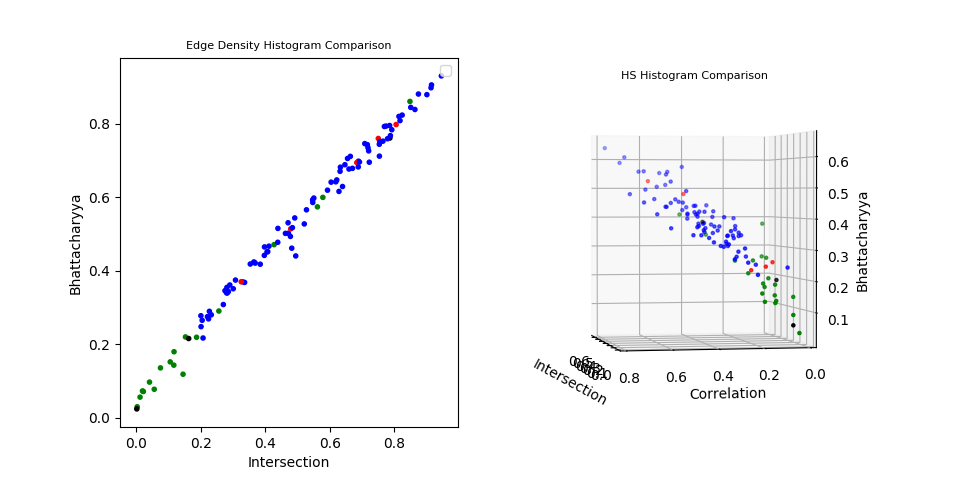

In [17]:
# Scatterplots of histogram comparisons

def colorLabel(im):
    if im.actual == 1 and im.label == 1:
        return "b"
    elif im.actual == 0 and im.label == 0: 
        return "g"
    elif im.actual == 1 and im.label == 0: 
        return "k"
    elif im.actual == 0 and im.label == 1: 
        return "r"
    
def getComps(imgs):
    comps = np.zeros([len(clf.test),5])
    col = []

    for i,im in enumerate(clf.test):
        comps[i,:] = im.edgeComp[0],im.edgeComp[2],im.hsComp[0],im.hsComp[1],im.hsComp[2]
        col.append(colorLabel(im))
    return comps,col
    
def plotComps(imgs):
    comps,col = getComps(imgs)
    labels = ["TP","TN","FN","FP"]
    
    fig = plt.figure(figsize=plt.figaspect(0.5))
    ax1 = fig.add_subplot(1,2,1)
    ax2 = fig.add_subplot(1,2,2,projection='3d')
    
    ax1.scatter(comps[:,0],comps[:,1],marker='.',c=col)
    #ax1.set_xlim([0,1]); ax1.set_ylim([0,1])
    ax1.set_title("Edge Density Histogram Comparison")
    ax1.set_xlabel("Intersection"); ax1.set_ylabel("Bhattacharyya")
    ax1.legend(col,labels)

    ax2.scatter(comps[:,2],comps[:,3],comps[:,4],marker='.',c=col)
    #ax2.set_xlim([0,1]); ax2.set_ylim([0,1]); ax2.set_zlim([0,1])
    ax2.set_title("HS Histogram Comparison")
    ax2.set_xlabel("Intersection"); ax2.set_ylabel("Correlation"); ax2.set_zlabel("Bhattacharyya")
    
    
%matplotlib notebook
plotComps(clf.test)

plt.show()

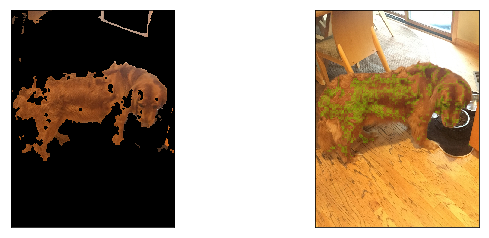

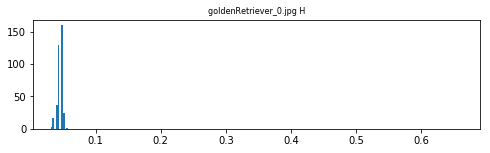

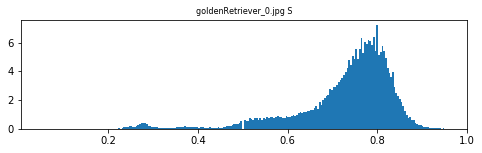

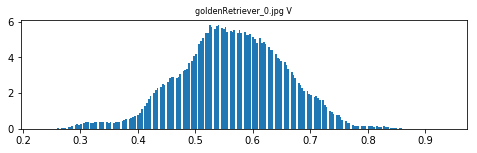

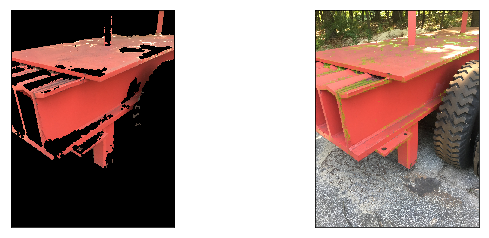

...

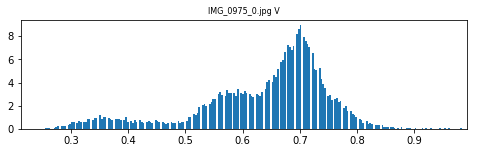

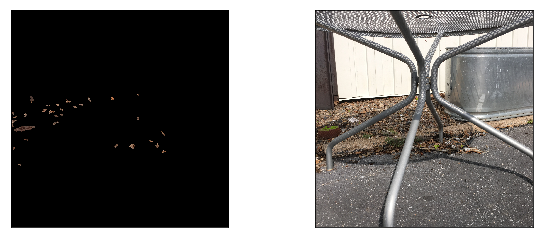

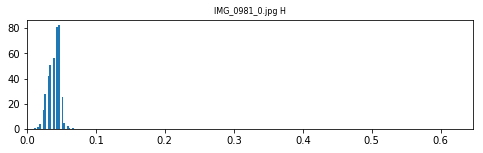

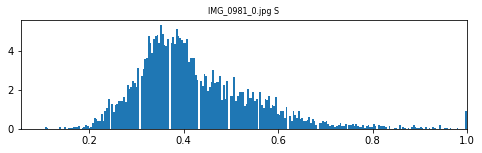

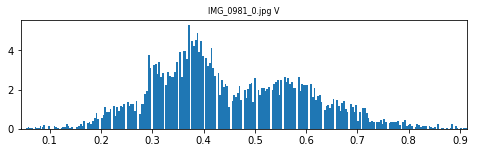

In [56]:

group = clf.getFalse()

for im in group:
    display(im.masked,im.edgeMap)
    h,s,v = splitComp(im.hsv)
    fullHist(h[im.gmask],title=im.name+" H")
    fullHist(s[im.gmask],title=im.name+" S")
    fullHist(v[im.gmask],title=im.name+" V")

plt.show()

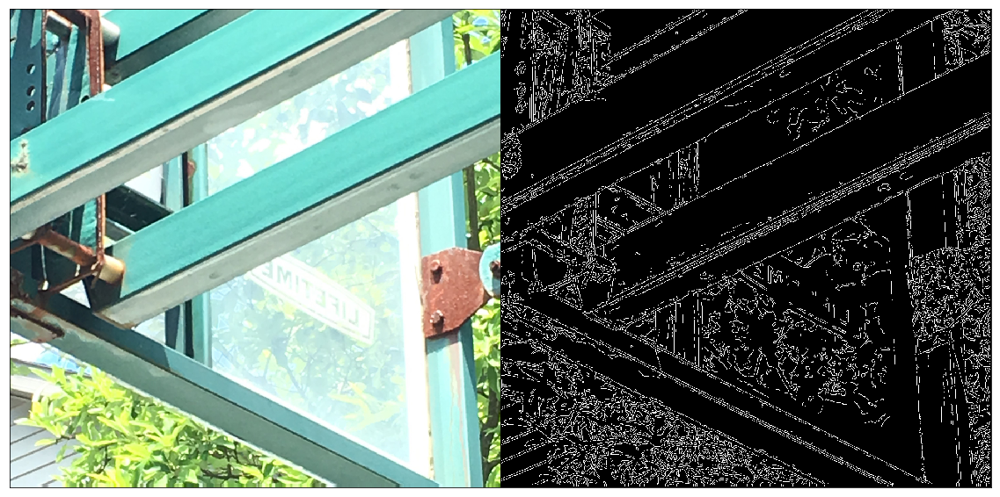

In [117]:
plt.rcParams['image.cmap'] = 'gray'


def smoothExample(img):
    sigs = [0.01,5.0,10.0,20.0]
    imgs = []
    for sig in sigs:
        filt = skimage.filters.gaussian(img,sigma=sig)
        imgs.append(filt)

    stacked = stack4(imgs)
    plt.imshow(stacked)
    plt.xticks([]); plt.yticks([])
    name = "smoothed"
    #plt.savefig('../figures/'+name+'.jpg',bbox_inches='tight')

def gradientExample(img,power):
    grad = skimage.filters.sobel(toGray(img))
    grad = np.power(grad,power)
    grad = skimage.util.img_as_ubyte(np.stack([grad,grad,grad],axis=-1))
    stacked = np.concatenate((img,grad),axis=1)
    plt.figure()
    plt.imshow(stacked)
    plt.xticks([]); plt.yticks([])
    name = "sobel"
    plt.savefig('../figures/'+name+'.jpg',bbox_inches='tight')
    
    
def maskExample(im):
    stacked = np.concatenate((im.rgb,im.masked),axis=1)
    plt.figure(figsize=(20,12))
    plt.imshow(stacked)
    plt.xticks([]); plt.yticks([])
    name = "masked"
    #plt.savefig('../figures/'+name+'.jpg',bbox_inches='tight')
    
    
def edgeExample(im):
    edge = canny(im.gray)
    ed = skimage.util.img_as_ubyte(np.stack([edge,edge,edge],axis=-1))
    stacked = np.concatenate((im.rgb,ed),axis=1)
    plt.figure(figsize=(20,12))
    plt.imshow(stacked)
    plt.xticks([]); plt.yticks([])
    name = "edges"
    #plt.savefig('../figures/'+name+'.jpg',bbox_inches='tight')
    
    
im = clf.test[3]

#smoothExample(im.rgb)
#gradientExample(im.rgb,0.7)
#maskExample(im)
edgeExample(im)

"""for im in clf.test[:10]:
    if im.edges == None:
        display(im.rgb,np.zeros([10,10]))
    else:
     display(im.rgb,im.edges)"""

plt.show()

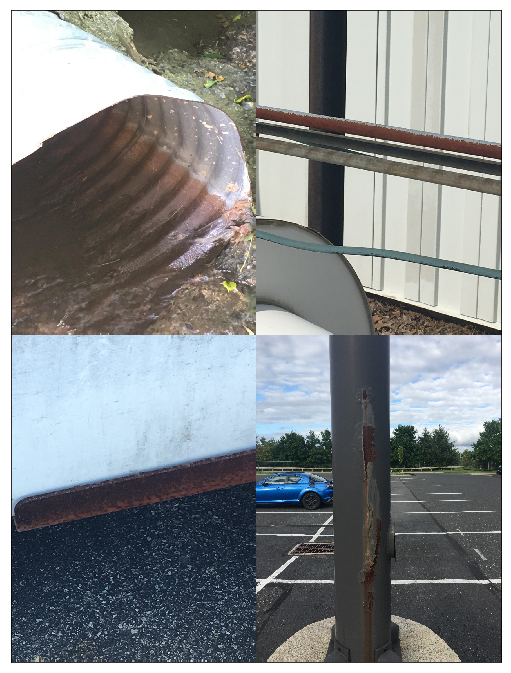

In [123]:
%matplotlib inline

#group = clf.pos
group = [im for im in clf.getFalse() if im.actual == 1]
#group = [im for im in clf.getFalse() if im.actual == 0]

group = [group[0],group[1],group[3],group[5]]

stacked = stack4([im.rgb for im in group])
plt.figure(figsize=(20,12))
plt.imshow(stacked)
plt.xticks([]); plt.yticks([])

"""for im in group:
    if im.label:
        stacked = im.getStacked(method="square")
        plt.figure(figsize=(20,12))
        plt.imshow(stacked)
        plt.xticks([]); plt.yticks([]); plt.title(im.name)
        im.histDisplay()"""

plt.savefig('../figures/'+"trick_square"+'.png',bbox_inches='tight')
plt.show()

In [ ]:
# Texture

%time clf.initTexture()
%time clf.compareEdgeHists()
clf.setTitles()
#clf.setFeatures()
#clf.prepFeatures()

imgs = [im.masked for im in clf.test if not im.isCorrect()]
titles = [im.title for im in clf.test if not im.isCorrect()]
displayAll(imgs,titles)

plt.show()

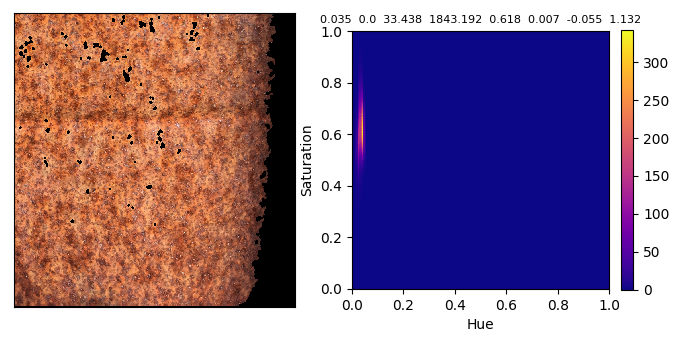

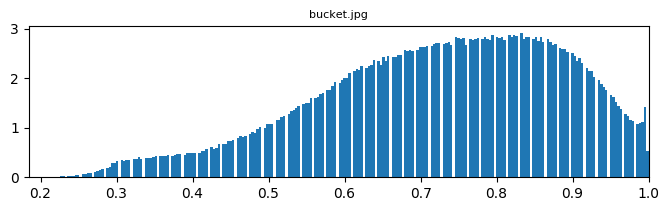

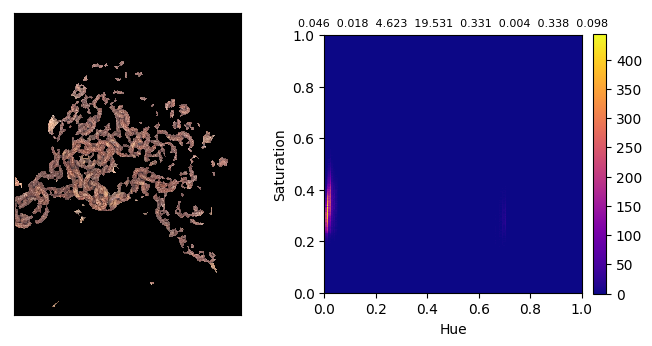

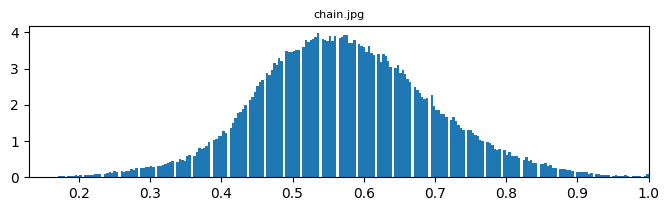

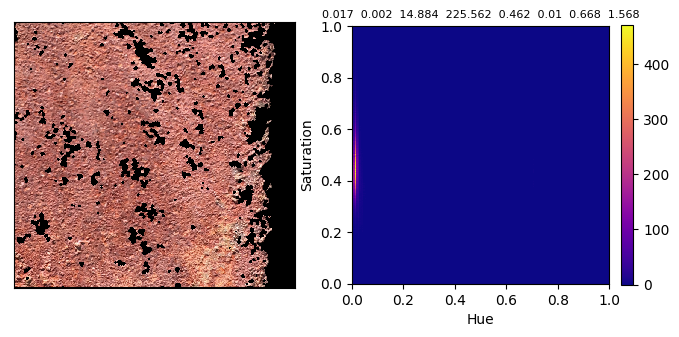

...

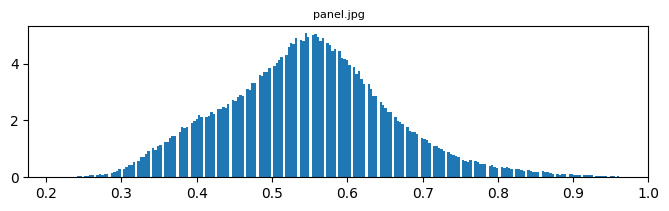

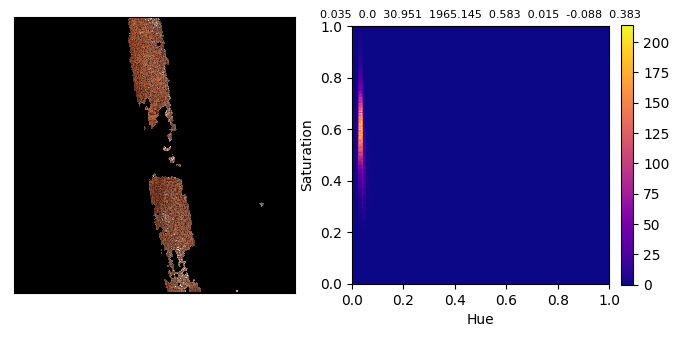

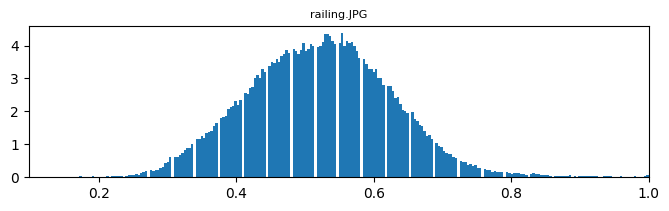

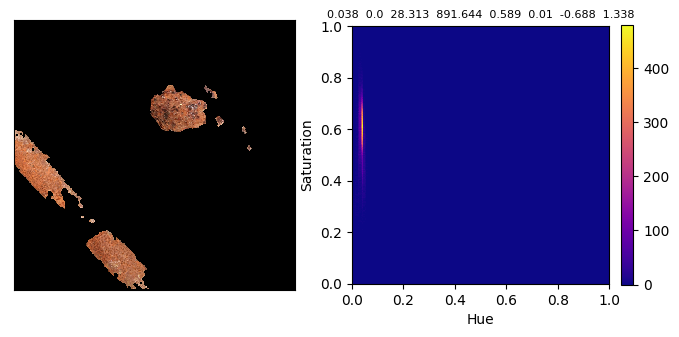

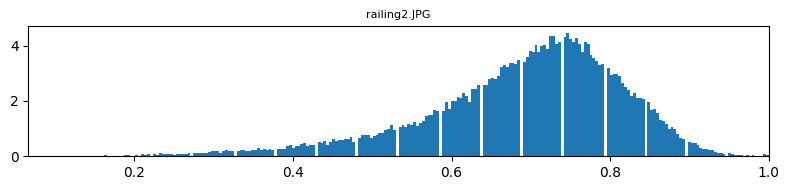

In [71]:
#group = clf.getFalse()
group = clf.pos
#group = [im for im in clf.test if im.label == 1]
#group = [im for im in clf.test if im.label == 0]
pixelAnalysis(group)

plt.tight_layout()
plt.show()

1606
1326
4440
107
Wall time: 5.27 s


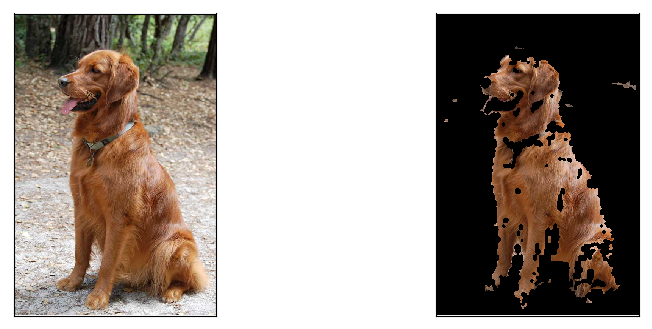

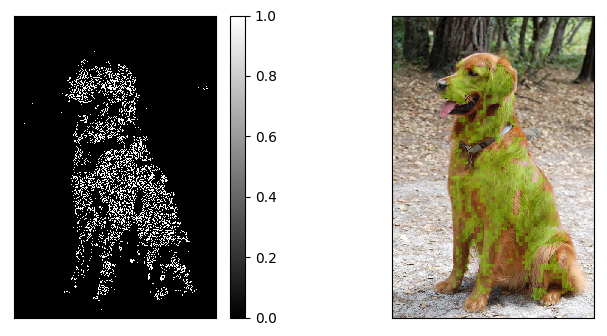

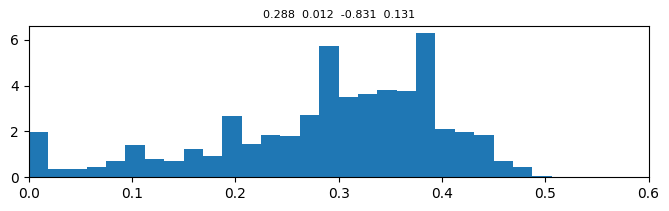

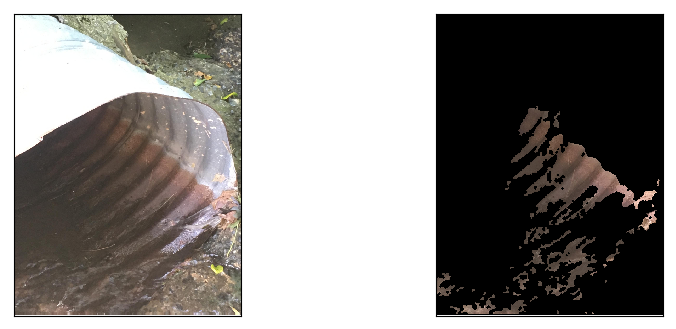

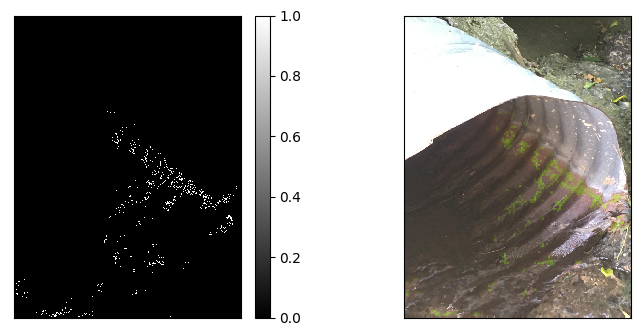

...

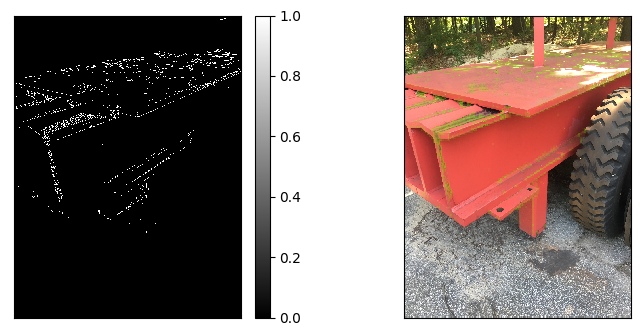

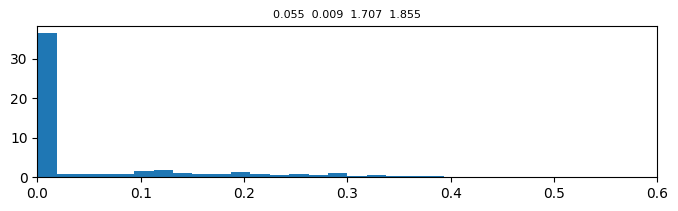

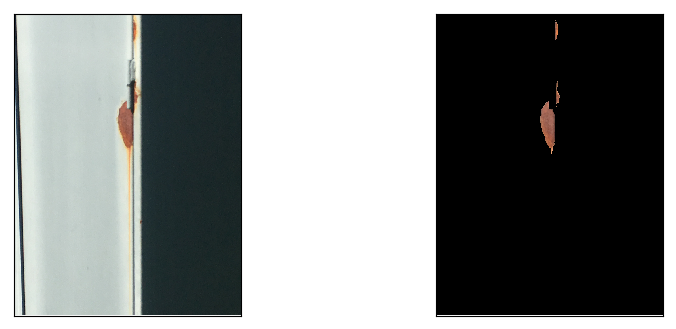

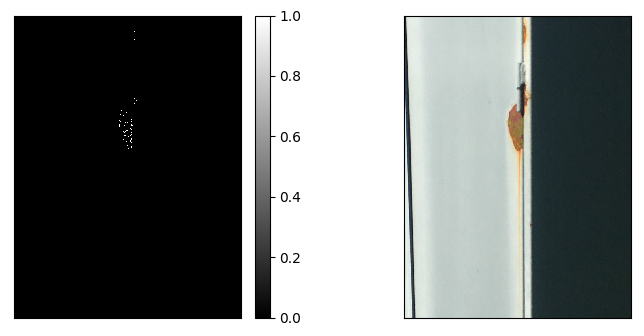

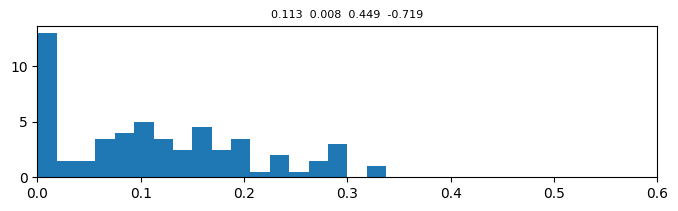

In [150]:
# Edges 
plt.rcParams['image.cmap'] = 'gray'
    
#
def edgeAnalysis(im,sig,edgeThr,nbins,plot=True):
    img = toGray(im.masked)
    edge = canny(img,mask=im.gmask,sigma=sig)
    edgeness = edgenessTotal(edge,im.redBlocks,im.redInds)
    
    inds = []
    for i in range(len(edgeness)):
        if edgeness[i] < edgeThr:
            inds.append(im.redInds[i])

    if plot:
        drawn = drawBlocksColorCoded(im.rgb,im.redInds,im.redBlocks[0].shape[0],edgeness[:])
        display(im.rgb,im.masked)
        display(edge,drawn)
    h = fullHist(edgeness,title=list2str(getStats(edgeness)),nbins=nbins,range=(0,0.5),plot=plot)
    return edgeness,h

def edgeAnalysisGroup(group,sig,edgeThr,nbins,plot=True):
    edge = []; hists = []
    for im in group:
        if len(im.redBlocks) > 0:
            print(len(im.redBlocks))
            edgeness,h = edgeAnalysis(im,sig,edgeThr,nbins,plot=plot)
            edge.append(edgeness); hists.append(h)
            
    return edge,hists


sig = 0.1
edgeThr = 0.2 # edgeness threshold
nbins = 32

#%time edgeP,histsP = edgeAnalysisGroup(clf.pos,sig,edgeThr,nbins,plot=True)

low = 0; high = 0.5
cen = np.linspace(low,high,nbins)
wid = cen[1] - cen[0]
avgP = np.mean(np.asarray(histsP),axis=0)
#histPlot(avgP,cen,wid)

%time edge,hists = edgeAnalysisGroup(clf.getFalse()[:4],sig,edgeThr,nbins)

plt.show()

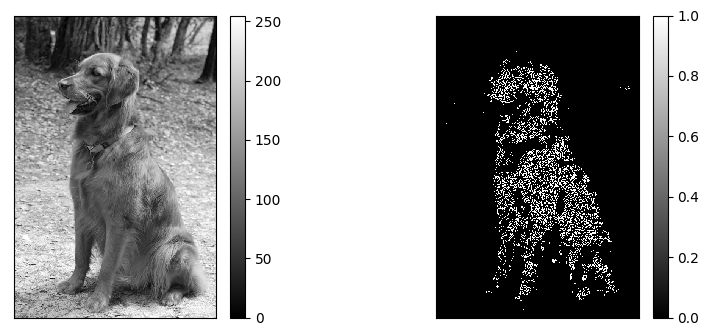

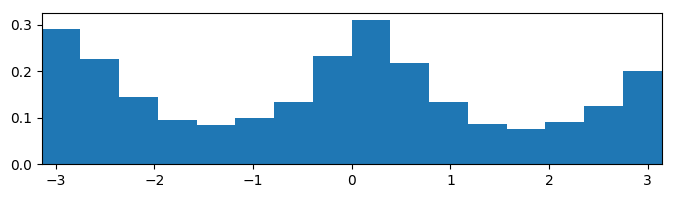

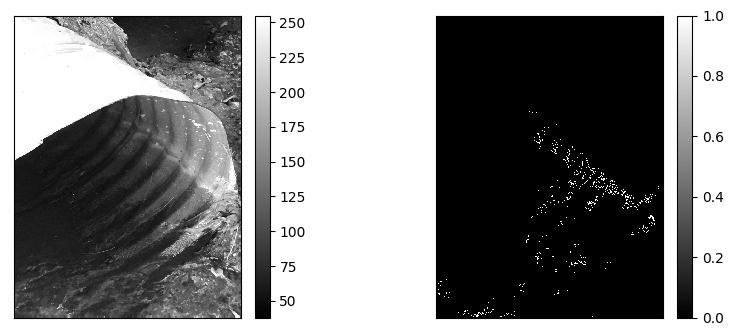

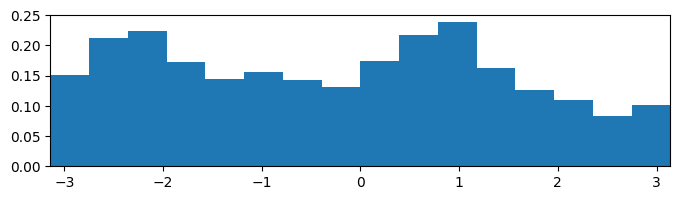

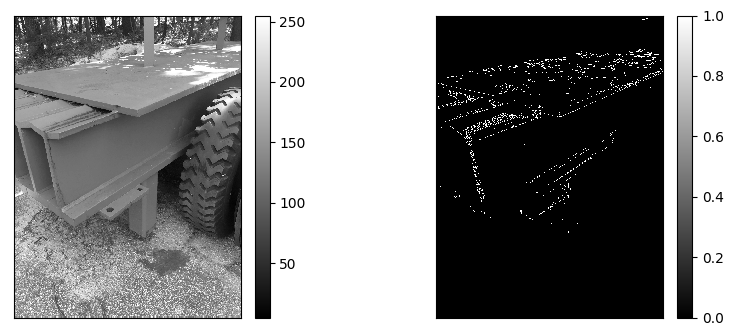

...

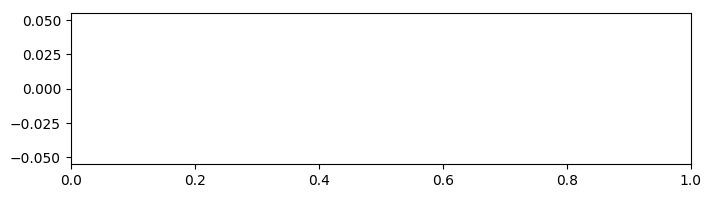

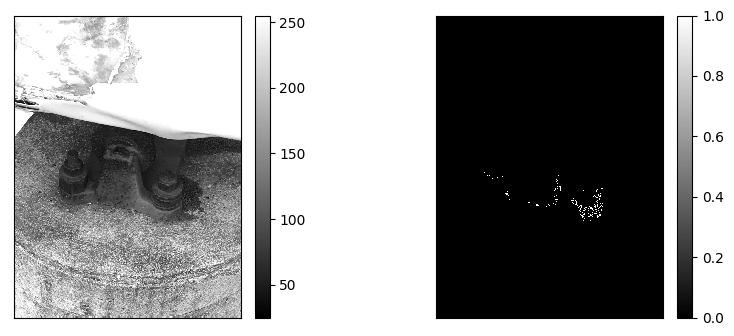

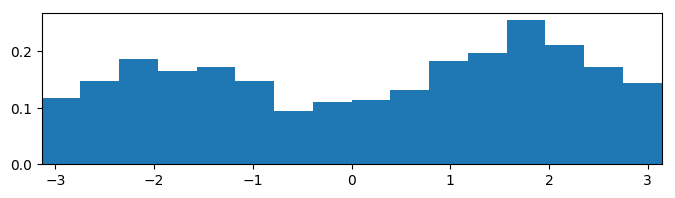

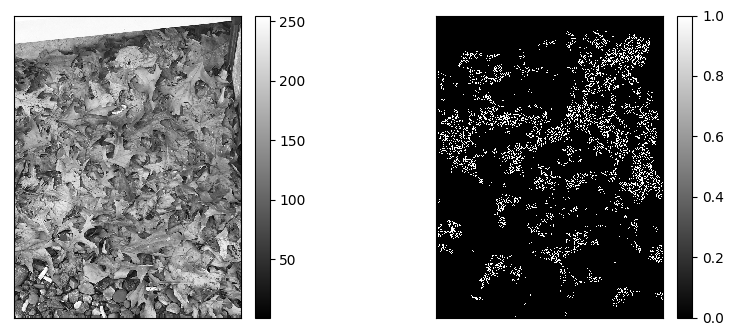

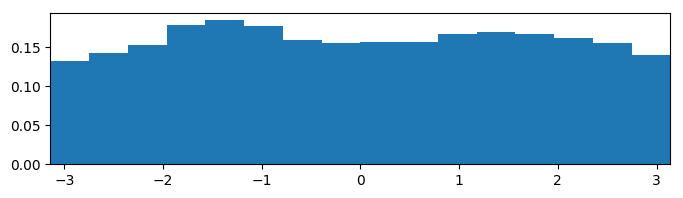

In [58]:
# Edge direction
plt.rcParams['image.cmap'] = 'gray'

def directionPlot(im,nbins=8,sig=0.1):
    edge = edges(im.gray,mask=im.gmask,sigma=sig)
    direc = edgeDir(getMasked(im.gray,im.gmask),mask=im.gmask)
    directions = direc[edge]
    
    display(im.gray,edge)
    fullHist(directions,nbins=nbins)

#group = clf.pos
group = clf.getFalse()
#group = [im for im in clf.test if im.label == 1]

nbins = 16
sig = 0.1
    
for im in group[:10]:
    directionPlot(im,nbins=nbins,sig=sig)
    
plt.show()

168
363
16
600
181
52
64
2293
77
382
33
334
159
47
24
246
49
97
98
41
72
114
28
53
43
176
10
242
207
79
56
132
31
5
197
64
38
645
97
40
110
542
15
30
127
42
101
69
15
16
22
178
515
200
199
199
723
363
31
36
18
36
32
55
37
91
134
66
188
14
68
170
85
53
81
450
21
54
17
32
75
10
105
221
281
24
Wall time: 1min 41s


<IPython.core.display.Javascript object>


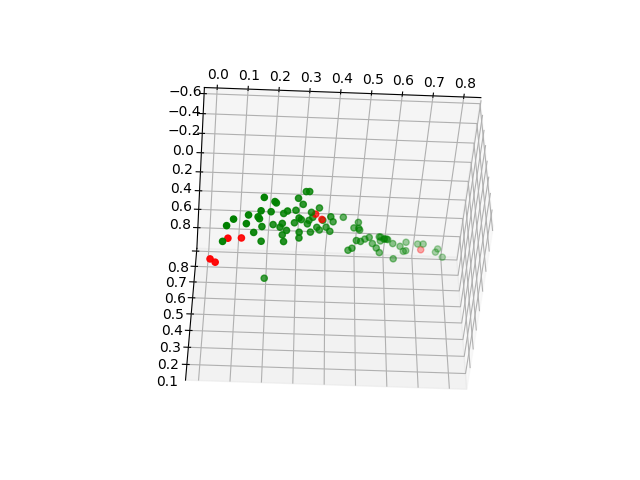

In [47]:

#%time edgeT,histsT = edgeAnalysisGroup(clf.test,space,comp,sig,edgeThr,minPix,nbins)
#%time edgeF,histsF = edgeAnalysisGroup(clf.getFalse(),space,comp,sig,edgeThr,minPix,nbins)
#%time edgeF,histsF = edgeAnalysisGroup(clf.getFalse(),space,comp,sig,edgeThr,minPix,nbins)

group = [im for im in clf.test if im.label == 1]
%time edge1,hists1 = edgeAnalysisGroup(group,space,comp,sig,edgeThr,minPix,nbins)

sims = []; col = []
for im,h in zip(group,hists1):
    sim = compareHist(avgP,h)
    sims.append(sim)
    title = list2str(sim)+" "+str(im.label)+" "+str(im.actual)
    if im.actual == 1 and im.label == 1: col.append('g')
    elif im.actual == 0 and im.label == 0: col.append('k')
    elif im.actual == 0 and im.label == 1: col.append('r')
    elif im.actual == 1 and im.label == 0: col.append('y')
        
sims = np.asarray(sims)

%matplotlib notebook
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(sims[:,0],sims[:,1],sims[:,2],c=col)
ax.set_xlabel("Intersection")
ax.set_ylabel("Correlation")
ax.set_zlabel("Bhattacharyya")

plt.show()

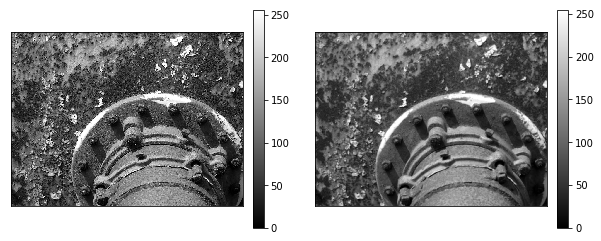

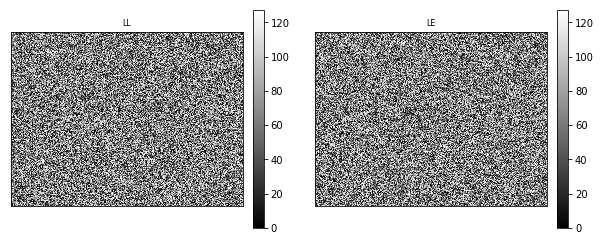

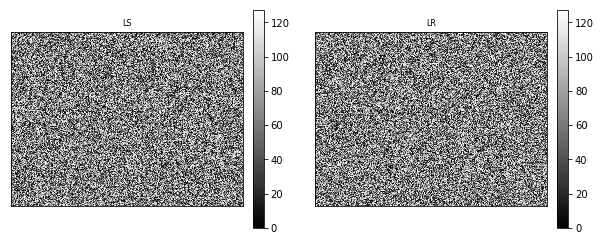

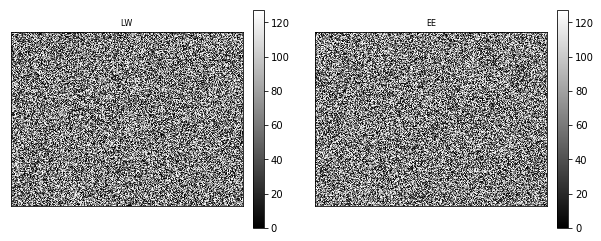

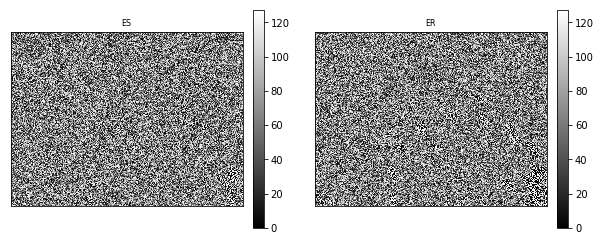

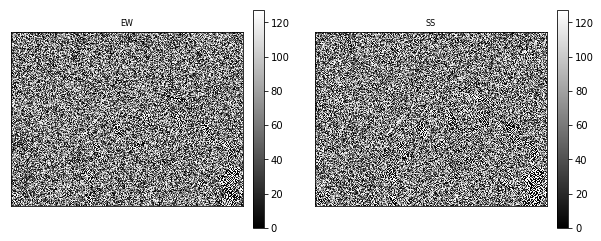

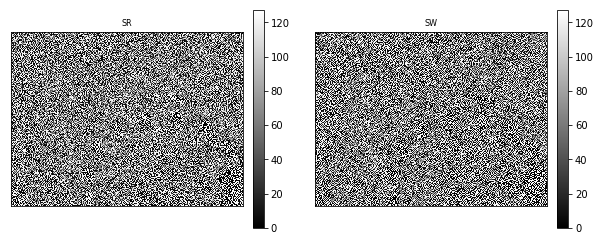

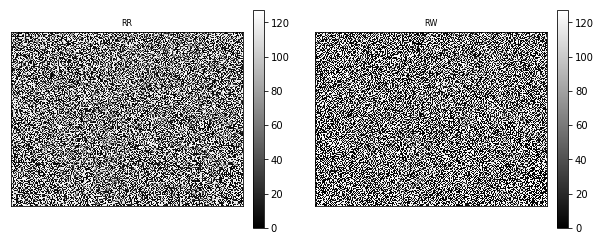

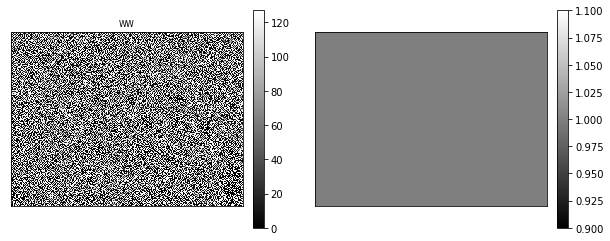

In [106]:
# Laws texture energy
plt.rcParams['image.cmap'] = 'gray'
%matplotlib inline

im = clf.pos[-8]
#im = clf.neg[3]
gray = im.gray #getMasked(im.gray,im.gmask)

size = 5
results = filterLaws(gray,size)
filts,names = combineLaws(results)

display(gray,smooth(gray,size))
displayAll(filts,titles=names)

plt.show()

In [8]:
# Wavelets 
plt.rcParams['image.cmap'] = 'gray'
#clf.setBlocks(8,0.9)

def waveletAnalysisAll(group,space,comps):
    avgs = []; stds = []
    for i,im in enumerate(group):
        if im.label:
            avg,std = waveletAnalysis(im.redBlocks,space,comps)
            avgs.append(avg); stds.append(std)     
    return avgs,stds

#
def barPlot(ax,avgs,stds,comps,title=""):
    width = 1.0 / len(comps)
    ind = np.arange(avgs.shape[1]) + 0.5*width
    colors = ['r','b','g']

    for i in range(len(comps)):
        ax.bar(ind+i*width,np.sqrt(avgs[i,:]),width,color=colors[i],yerr=stds[i,:])
        
    subbands = ['eA','eH3','eV3','eD3','eH2','eV2','eD2','eH1','eV1','eD1']
    ax.set_xlim([0,avgs.shape[1]]); ax.set_ylim([0,1.1])
    ax.set_ylabel('Percent of Energy')
    ax.set_title(title)
    ax.set_xticks(ind+width)
    ax.set_xticklabels(subbands[:])
    #ax.set_xticklabels([])
    
#
def waveletVisualize(im,space,comps):
    avgs,stds = waveletAnalysis(im.redBlocks,space,comps)
    if len(im.redBlocks) == 0:
        return
    
    d = im.redBlocks[0].shape[0]
    title = im.name+" in "+space+", d="+str(d)+" nb="+str(len(im.redBlocks))
    
    if space == "gray":
        img = convert(im.masked,space)[:,:]
    else:
        img = convert(im.masked,space)[:,:,comps[0]]
    
    fig,ax = plt.subplots(nrows=1,ncols=2)
    ax[0].imshow(img)
    ax[0].set_xticks([]); ax[0].set_yticks([]);
    barPlot(ax[1],np.asarray(avgs),np.asarray(stds),comps,title=title)

#
def waveletVisualizeAll(group,space,comps):
    for im in group:
        if im.label:
            print(len(im.redBlocks))
            waveletVisualize(im,space,comps)

#space = "gray"
#space = "hsv"
space = "ycbcr"
comps = [2]

#%time waveletVisualizeAll(clf.pos,space,comps)
#%time waveletVisualizeAll(clf.neg,space,comps)
#%time waveletVisualizeAll(clf.test,space,comps)

#plt.tight_layout()
plt.show()

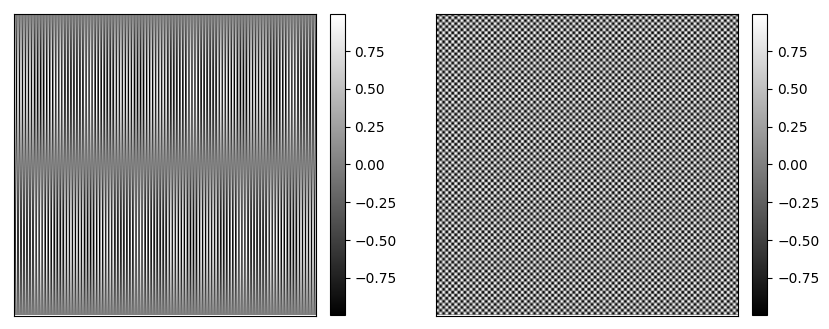

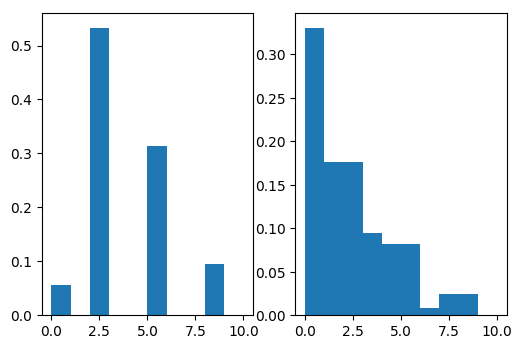

In [30]:
# wavelet testing

def wave2(k1,k2,n=1000):
    X,Y = np.meshgrid(np.linspace(0,2*np.pi,n),np.linspace(0,2*np.pi,n))
    return np.multiply(np.sin(k1*X),np.sin(k2*Y))
  
k1x = 100; k1y = 1
k2x = 50; k2y = 50
wav1 = wave2(k1x,k1y)
wav2 = wave2(k2x,k2y)

en1 = waveletEnergy(wav1)
en2 = waveletEnergy(wav2)

display(wav1,wav2)

width = 1.0
ind = np.arange(en.size) + 0.5*width
fig,ax = plt.subplots(nrows=1,ncols=2)
ax[0].bar(ind,en1,width)
ax[1].bar(ind,en2,width)

plt.show()

In [115]:

#space = "gray"
space = "ycbcr"
#space = "yiq"
#space = "hsv"
comps = [2]

%time avgP,stdP = waveletAnalysisAll(clf.pos,space,comps)
%time avgN,stdN = waveletAnalysisAll(clf.neg,space,comps)
%time avgT,stdT = waveletAnalysisAll(clf.test,space,comps)


Wall time: 48.3 s
Wall time: 10.1 s
Wall time: 13.5 s


(928, 696)
(832, 776)
(816, 792)
(784, 824)
(824, 784)
(816, 792)
(696, 928)
(696, 928)
(896, 720)
(792, 816)
(792, 816)
(696, 928)
(696, 928)
(680, 944)
(696, 928)
(784, 824)
Wall time: 1min 30s
(696, 928)
(608, 720)
(896, 720)
(840, 768)
(656, 984)
(272, 400)
(360, 472)
(696, 928)
Wall time: 23.4 s


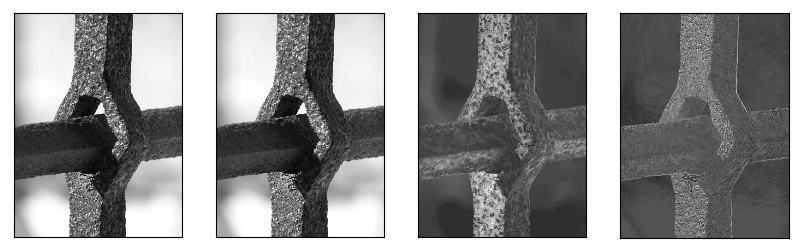

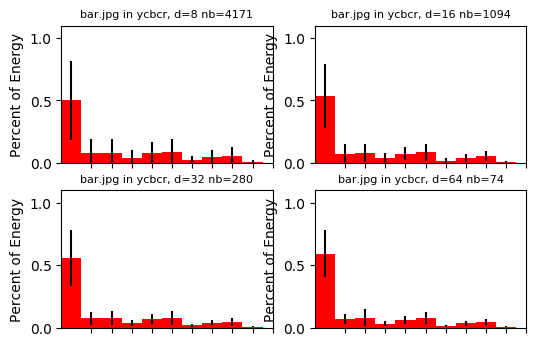

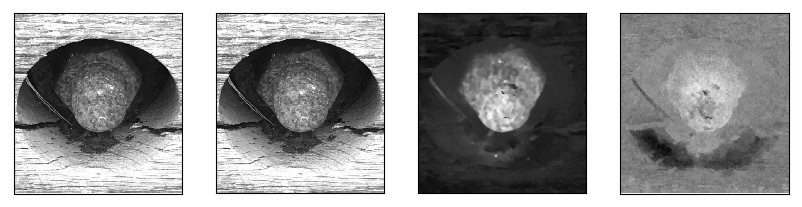

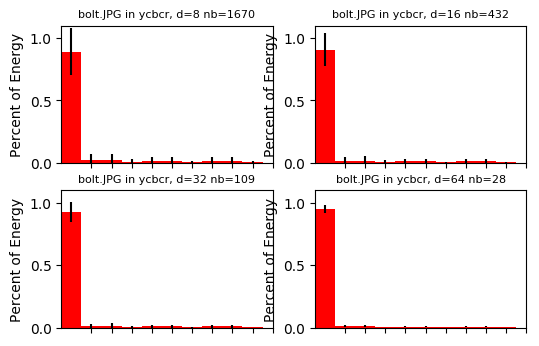

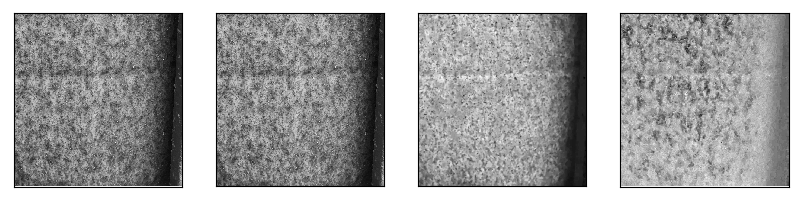

...

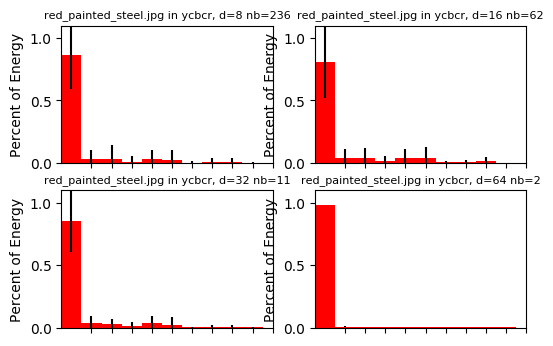

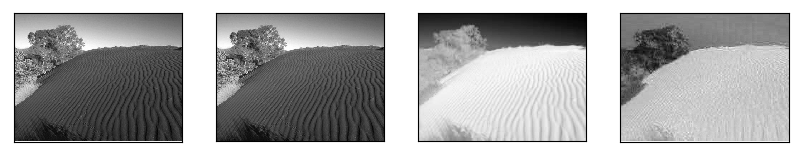

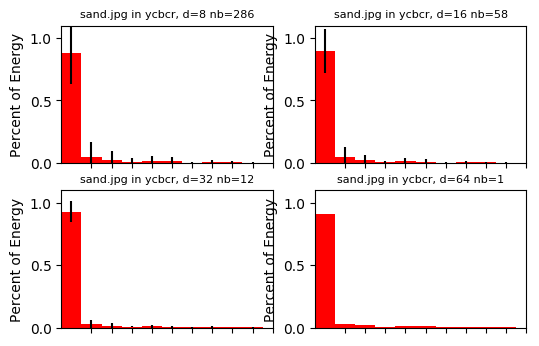

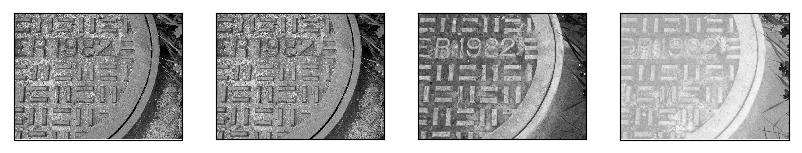

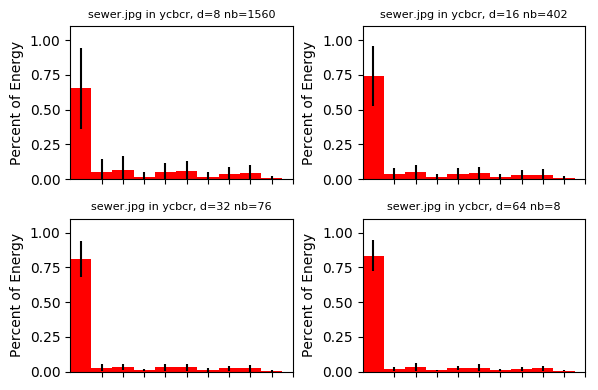

In [113]:
# Multiscale wavelet approach
plt.rcParams['image.cmap'] = 'gray'

def waveletVisualizeMS(im,space,comps,sizes,blockThr):
    displayComp(im.rgb,space)
    fig,axes = plt.subplots(nrows=2,ncols=2)
    
    for ax,d in zip(axes.flat,sizes):
        im.setRedBlocks(d,blockThr)
        if len(im.redBlocks) == 0: break
        avgs,stds = waveletAnalysis(im.redBlocks,space,comps)
        title = im.name+" in "+space+", d="+str(d)+" nb="+str(len(im.redBlocks))
        barPlot(ax,avgs,stds,comps,title=title)

def waveletVisualizeAllMS(group,space,comps,sizes,blockThr):
    for im in group:
        if im.label:
            print(im.shape)
            waveletVisualizeMS(im,space,comps,sizes,blockThr)

space = "ycbcr"
comps = [2]
blockThr = 0.9
sizes = [8,16,32,64]

%time waveletVisualizeAllMS(clf.pos,space,comps,sizes,blockThr)
%time waveletVisualizeAllMS(clf.neg,space,comps,sizes,blockThr)
#%time waveletVisualizeAllMS(clf.test,space,comps,sizes,blockThr)

plt.tight_layout()
plt.show()

In [178]:
# Classification

temp = clf.testLabels

clf.svm.C = 0.5
clf.train()
clf.predict()

print(temp)
print(clf.testLabels)
clf.testLabels = temp

{'C': 0.5, 'cache_size': 200, 'class_weight': None, 'coef0': 0.0, 'decision_function_shape': None, 'degree': 3, 'gamma': 'auto', 'kernel': 'rbf', 'max_iter': -1, 'probability': False, 'random_state': None, 'shrinking': True, 'tol': 0.001, 'verbose': False}
[ 0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.
  1.  1.  1.  0.  0.]
[ 0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.
  1.  1.  1.  0.  0.]


In [162]:
# Dimensionality Reduction

from sklearn.decomposition import PCA
from sklearn.feature_selection import VarianceThreshold

nc = 13
thresh = (0.8*(1-0.8))

pca = PCA(n_components=nc)
#sel = VarianceThreshold(threshold=thresh)

pca.fit(clf.)
#new = sel.fit_transform(feat)
print(pca.explained_variance_ratio_)


[ 0.894   0.0794  0.0157  0.005   0.0028  0.0022  0.0005  0.0002  0.0002
  0.0001  0.      0.      0.    ]


In [202]:
# CoV and GLCM energy histograms

def covHists(group):
    covs = []
    for im in group:
        cov = covAll(im.gray,im.mask,im.redBlocks,im.redInds)
        covs.append(cov)
        fullHist(cov,title=im.name)
    return ens

def glcmHists(group):
    ens = []
    for im in group:
        en = glcmEnergyAll(im.redBlocks)
        ens.append(en)
        fullHist(en,title=im.name)
    return ens

size = 16
blockThr = 0.9
clf.setBlocks(size,blockThr)
#group = clf.pos
#group = clf.neg
group = clf.test

covs = covHists(group)
#glcmEn = glcmHists(group)

plt.tight_layout()
plt.show()

3
532
814
977
1811
2
626
Wall time: 0 ns
[]


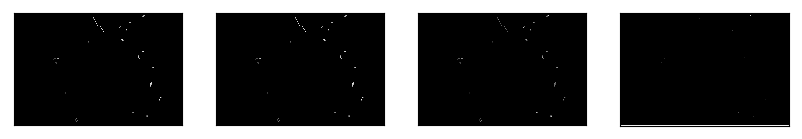

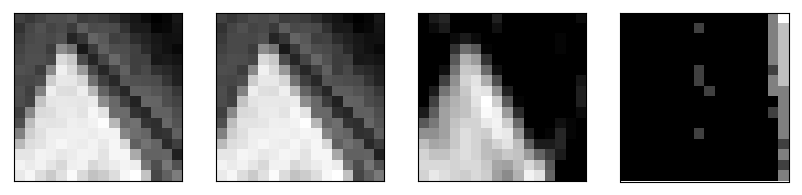

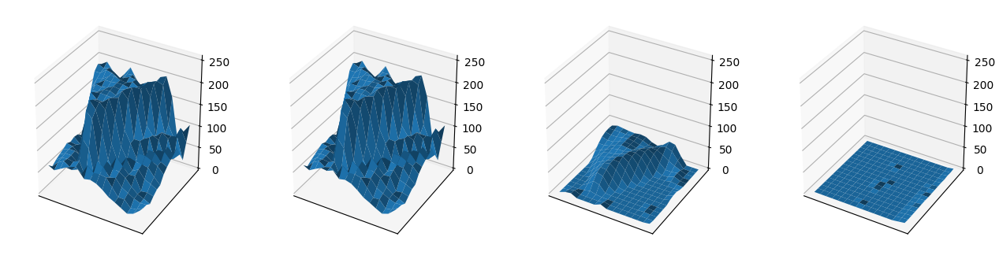

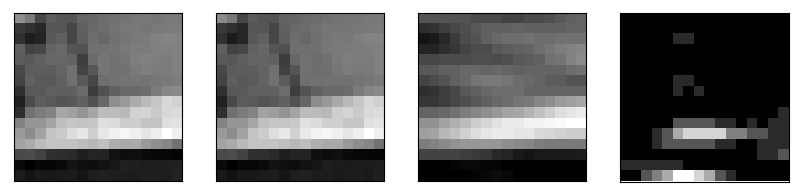

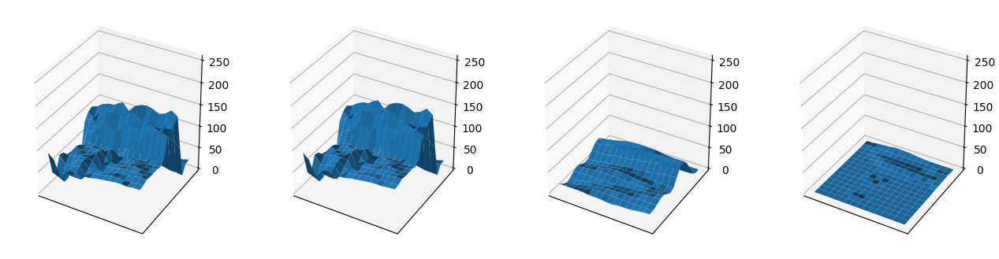

...

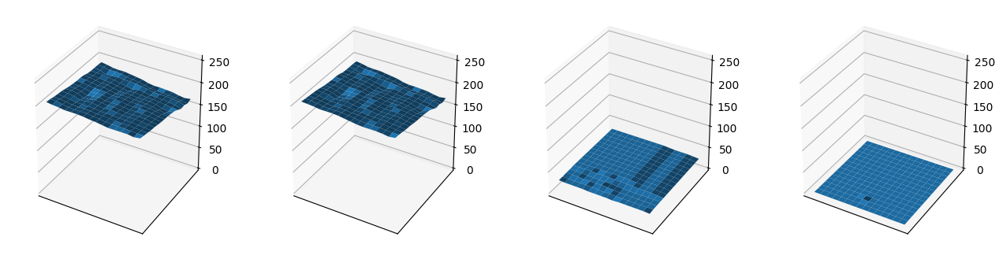

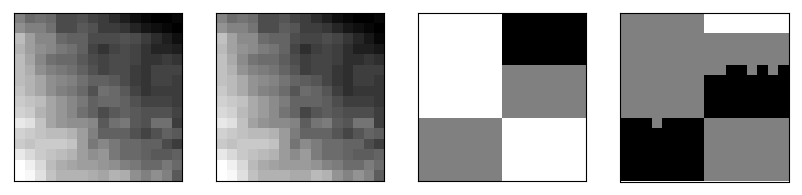

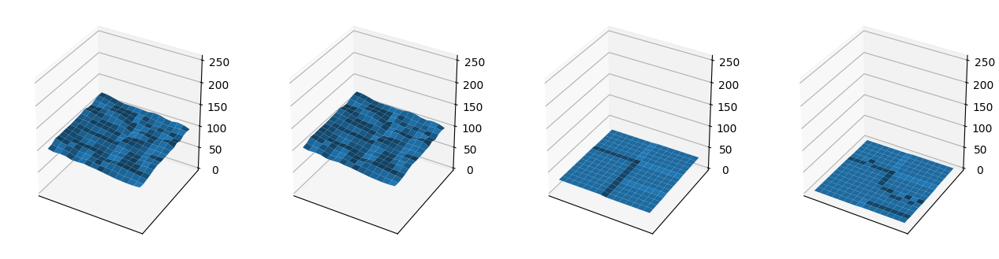

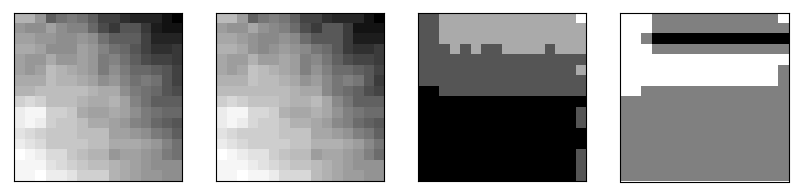

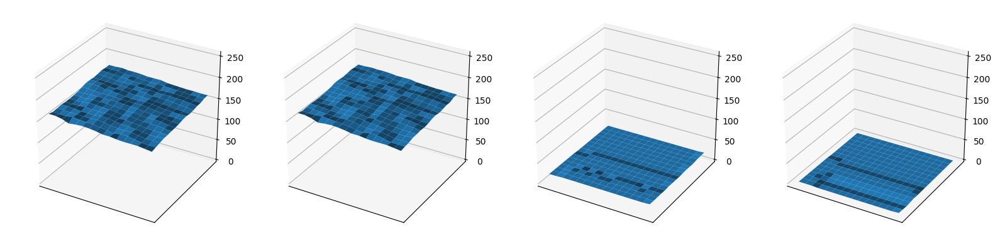

In [78]:
# 3D plotting
plt.rcParams['image.cmap'] = 'gray'

def displayOne3D(img,space):
    comps = get4Comps(img,space)
    X,Y = getMesh(comps[0])
    
    fig = plt.figure(figsize=plt.figaspect(0.25))
    for i,comp in enumerate(comps):
        ax = fig.add_subplot(1,len(comps),i+1,projection='3d')
        ax.plot_surface(X,Y,toByte(comp))
        ax.set_xticks([]); ax.set_yticks([])
        ax.set_zlim(0,255)

def display3D(imgs,space):
    for im in imgs:
        displayComp(im,space)
        displayOne3D(im,space)

d = 16
blockThr = 0.9
clf.setBlocks(d,blockThr)
#space = "hsv"
#space = "rgb"
space = "ycbcr"
num = 4

imgs = clf.getFalse()

blocks = []
titles = []
for im in imgs:
    print(len(im.redBlocks))
    bls,inds = im.randBlocks(num)
    displayComp(im.masked,space)
    display3D(bls,space)
    

%time display3D(blocks,space)
print(titles)

plt.tight_layout()
plt.show()

Wall time: 26.3 s


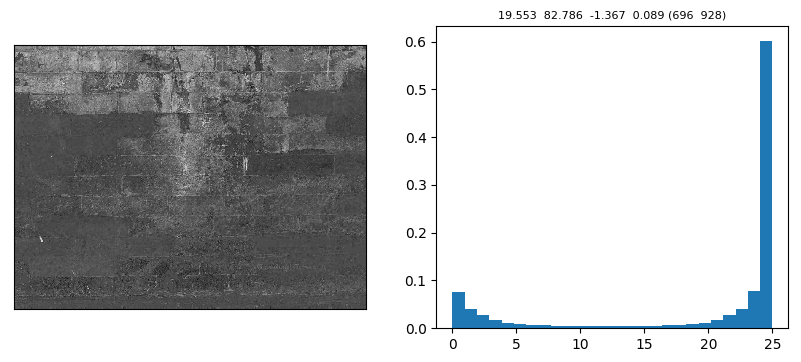

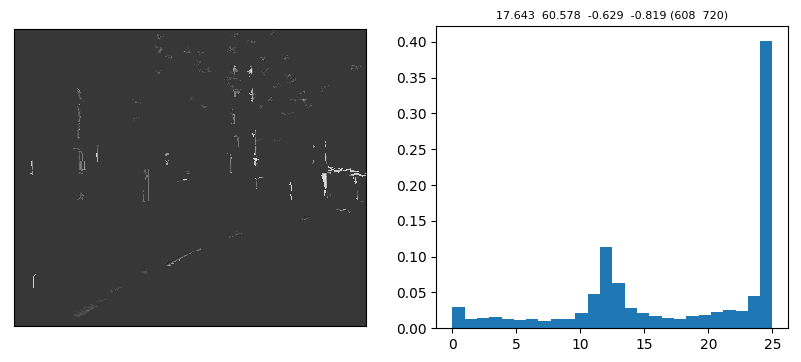

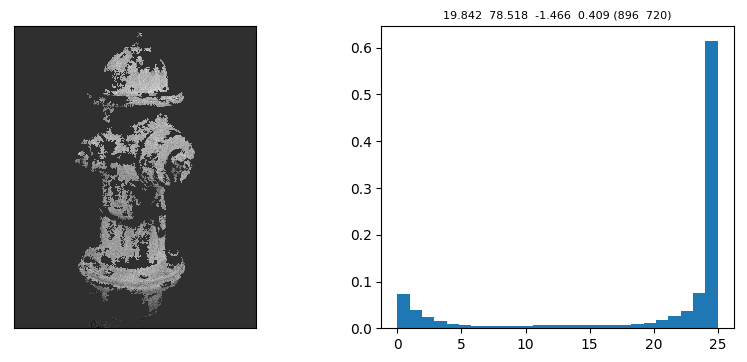

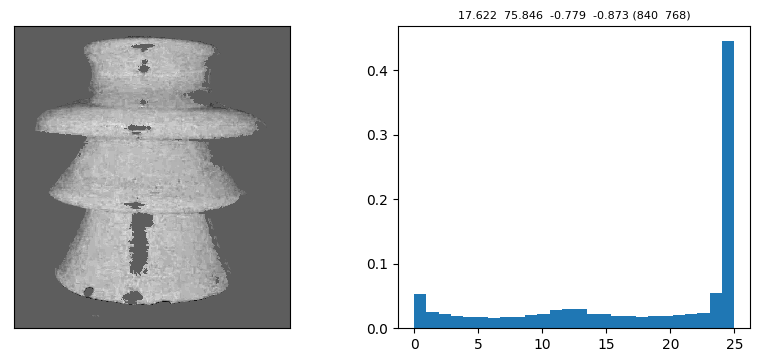

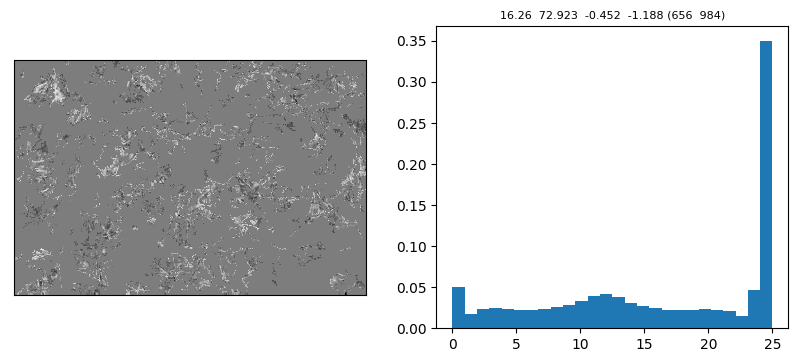

...

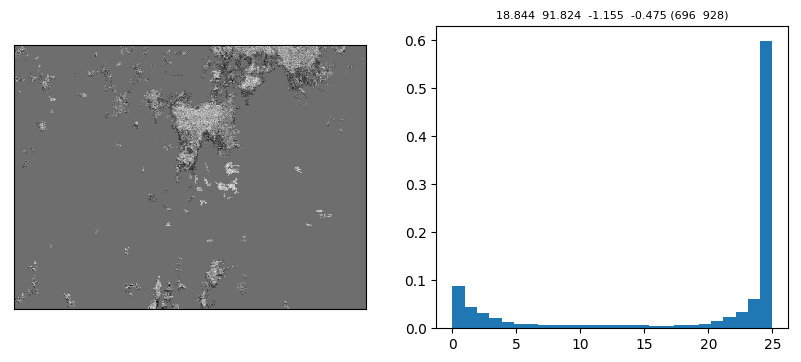

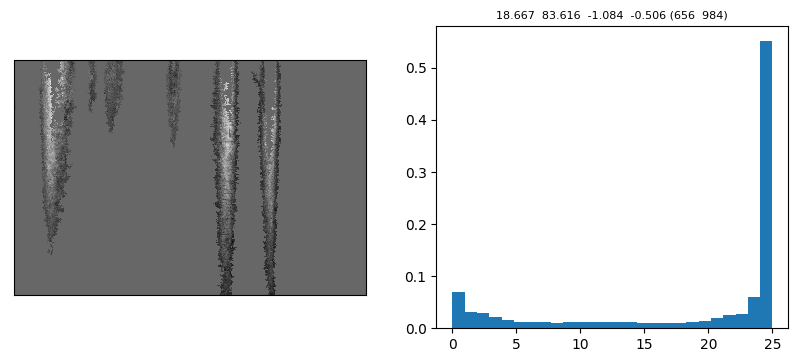

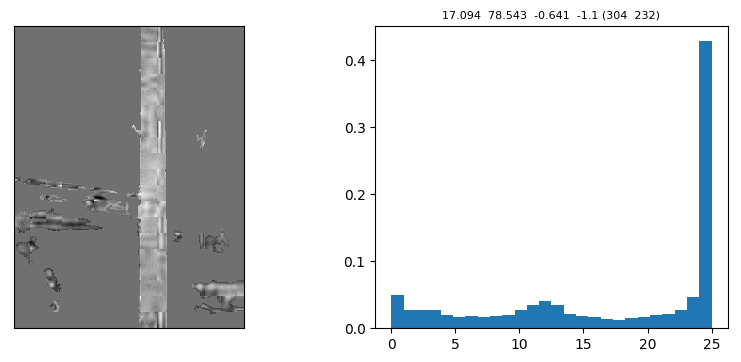

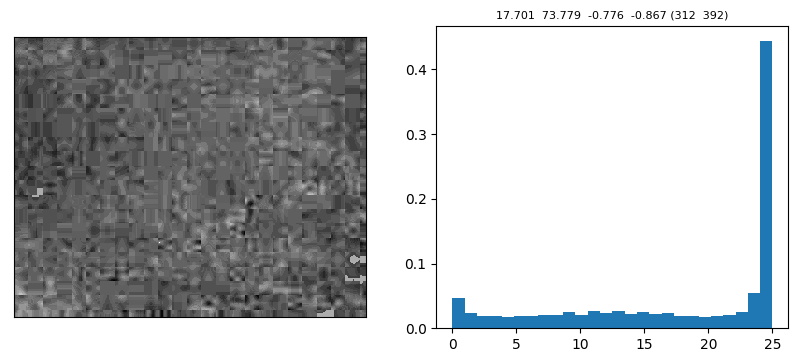

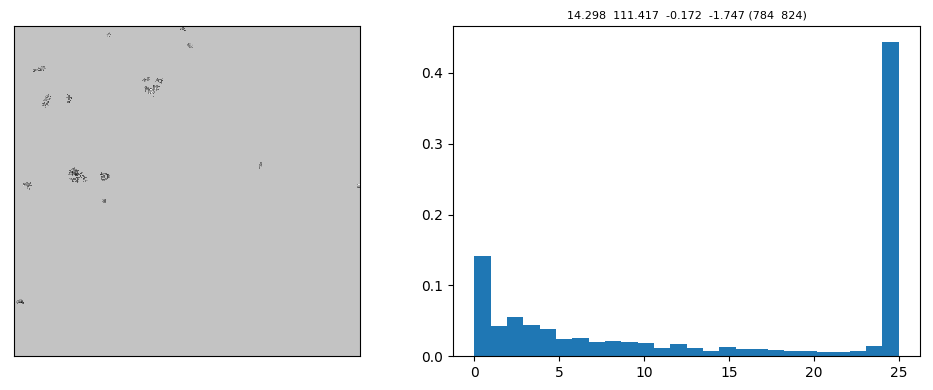

In [40]:
# Local binary pattern

#
def lbp(img,P=1,R=8):
    return feature.local_binary_pattern(img,P,R,method='uniform')

#
def lbpHist(im,P,R,space,comp):
    if space == "gray":
        img = im.gray
    else:
        img = convert(im.rgb,space)[:,:,comp]
    pat = lbp(img,P,R)
    
    data = pat[im.gmask]
    his,center,wid = hist(data,nbins=np.amax(pat)+1)
    plotImgHist(getMasked(img,im.gmask),his,center,wid,text=list2str(getStats(data))+" ("+list2str(im.shape)+")")

#
def lbpHistAll(group,P,R,space,comp):
    for im in group:
        lbpHist(im,P,R,space,comp)

        
group = clf.neg + clf.test
#space = "gray"
space = "ycbcr"
#space = "hsv"
comp = 2

R = 2 # radius of circle
P = R*8 # circularly symmetric neighbour set points

%time lbpHistAll(group,P,R,space,comp)

plt.tight_layout()
plt.show()

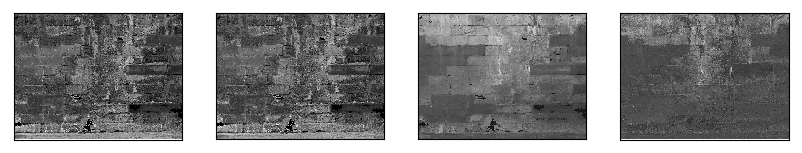

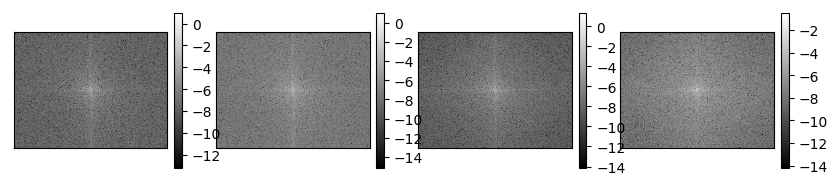

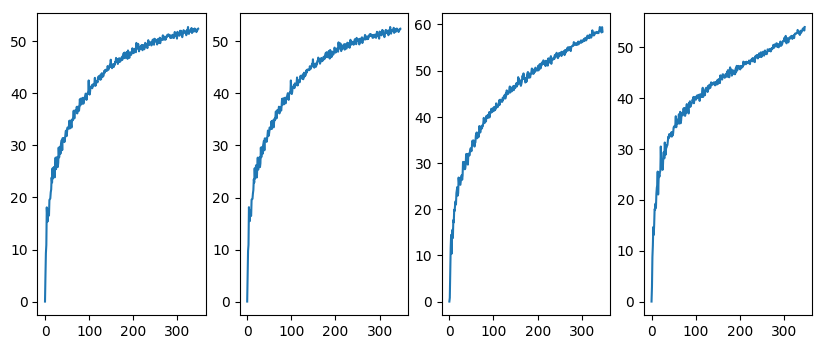

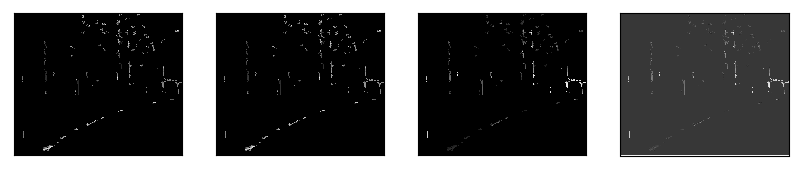

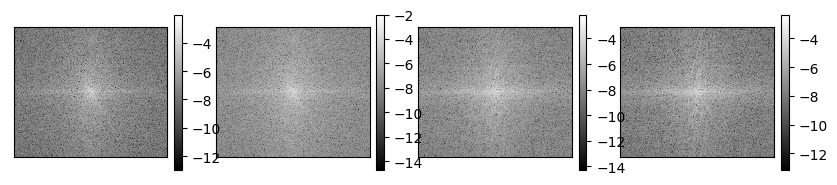

...

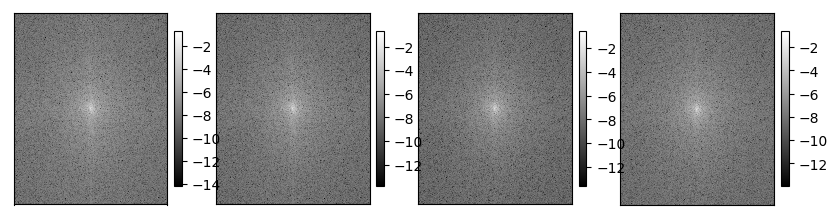

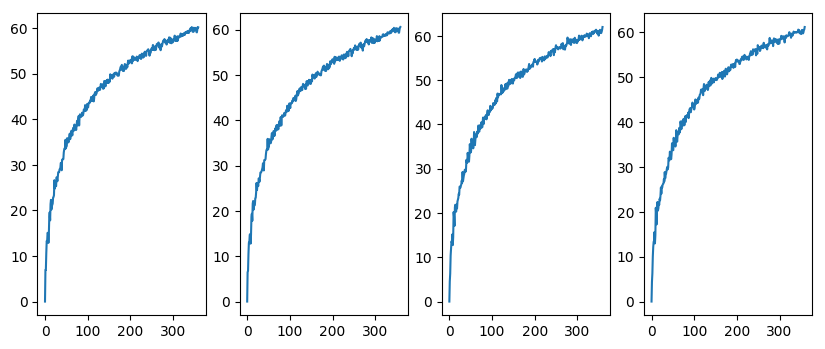

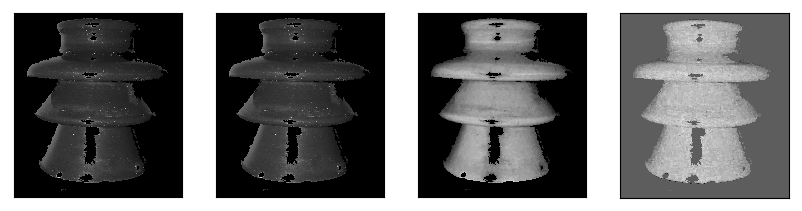

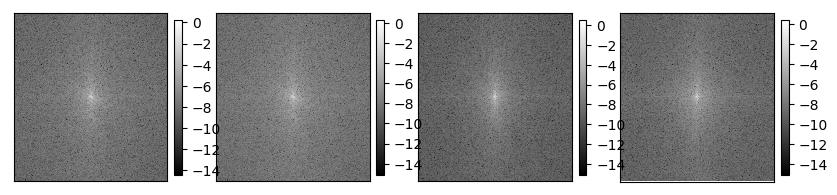

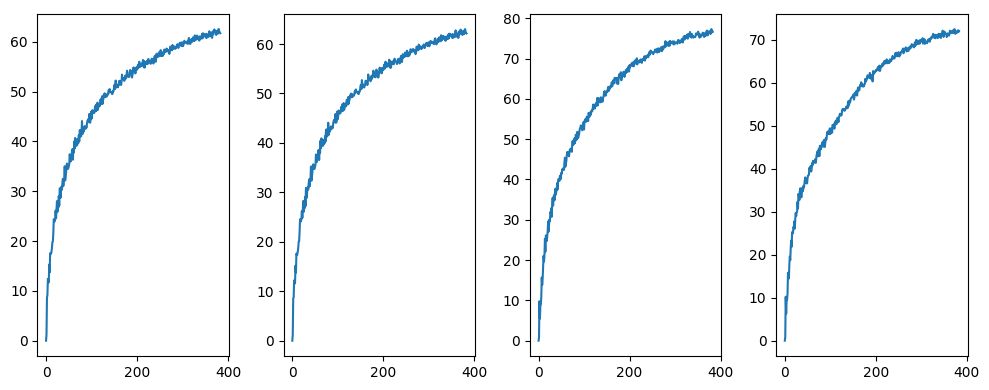

In [8]:
# Full image fourier analysis
plt.rcParams['image.cmap'] = 'gray'

def fftEnergyMeasure(fft):
    bins = int(np.amin(fft.shape)/2)
    meas = np.zeros(bins)
    r = int(fft.shape[0]/2)
    c = int(fft.shape[1]/2)
    
    for i in range(1,bins):
        rr,cc = skimage.draw.circle_perimeter(r,c,i,shape=fft.shape)
        meas[i] = energy(np.log(fft[rr,cc])) / (np.pi * i * 2)
                
        #rr,cc = skimage.draw.circle(r,c,i,shape=fft.shape)
        #meas[i] = energy(fft[rr,cc]) / (np.pi * i ** 2)
        
    return meas

def fftEnergyPlot(im,space):
    ffts = fourierAll(im.masked,space)
    fftShift = [np.fft.fftshift(ff) for ff in ffts]
    displayComp(im.masked,space)
    displayFour(np.log(fftShift))
    
    results = []
    for shift in fftShift:
        results.append(fftEnergyMeasure(shift))
    
    fig,axes = plt.subplots(nrows=1,ncols=4,figsize=(10,4))
    for res,ax in zip(results,axes):
        ax.plot(res)
    
    return results

space = "ycbcr"

for im in clf.neg[:4]:
    results = fftEnergyPlot(im,space)
    

plt.tight_layout()
plt.show()

In [18]:
# Image blocks Fourier Analysis

# 
def allEnergiesFFT(im,d,thr,space,log=False):
    energies = []
    print(len(im.redBlocks))
    for i in range(len(im.redBlocks)):
        en = allEnergy(fourierAll(im.redBlocks[i],space,log=log))
        energies.append(en)
        
    return np.asarray(energies)

#
def energyHistFFT(im,d,thr,space,logE=False,logF=False):
    energies = allEnergiesFFT(im,d,thr,space,log=logF)
    if logE: energies = np.log(energies)    
    if energies.size == 0: return energies
    
    params = energies.shape[1]
    fig,ax = plt.subplots(nrows=1,ncols=params,figsize=(10,3))
    
    for i in range(params):
        data = energies[:,i]
        if np.all(np.isfinite(data)):
            his,center,wid = hist(data)
            ax[i].bar(center,his,width=wid)
            #ax[i].set_xlim([0,1000])
            #ax[i].set_ylim([0,0.1])
            #ax[i].set_title()
    return energies

#
def getColorCodedEnergies(im,energies):
    params = energies.shape[1]
    drawn = []
    
    for i in range(params):
        vals = energies[:,i] / np.amax(energies[:,i])
        draw = np.copy(im.rgb)
        drawn.append(drawBlocksColorCoded(draw,im.redInds,d,vals))

    return drawn

# 
def fourier2Analysis(group,d,thr,space,logE,logF):
    for im in group:
        print(im.shape)
        energies = energyHistFFT(im,d,thr,space,logE=logE,logF=logF)
        if energies.size == 0: continue
        drawn = getColorCodedEnergies(im,energies)
        displayComp(im.rgb,space)
        displayFour(drawn,colorbar=False)

d = 16
blockThr = 0.9
clf.setBlocks(d,blockThr)
logE = False # use log of energy
logF = True # use log of fft

#space = "hsv"
space = "ycbcr"
#space = "yiq"

#%time fourier2Analysis(clf.pos,d,thr,space,logE,logF)
%time fourier2Analysis(clf.neg,d,thr,space,logE,logF)
%time fourier2Analysis(clf.test,d,thr,space,logE,logF)

plt.tight_layout() 
plt.show()

(696, 928)
2481
(608, 720)
23
(896, 720)
513


KeyboardInterrupt: 

(872, 1160, 3)
(768, 1312, 3)
(872, 1160, 3)
(816, 1232, 3)
 

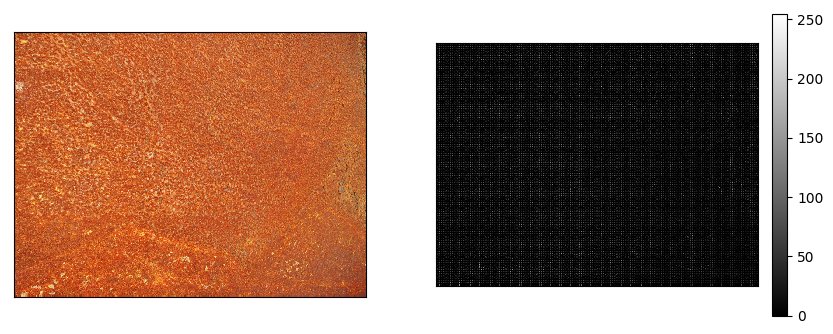

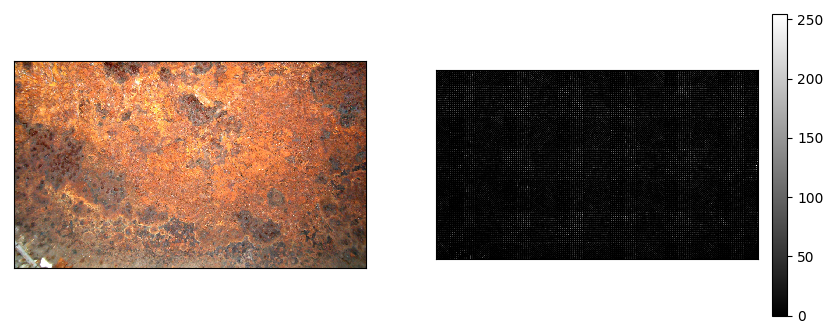

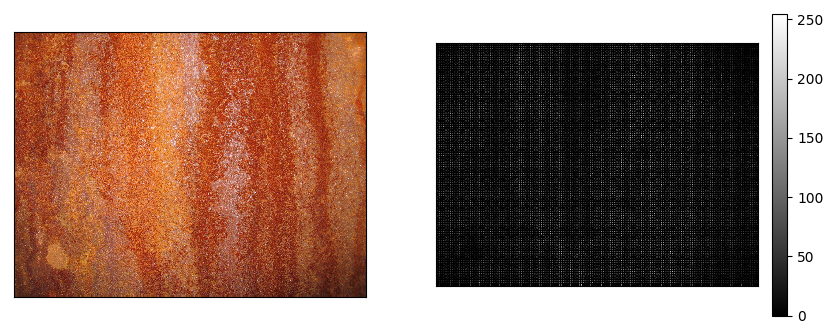

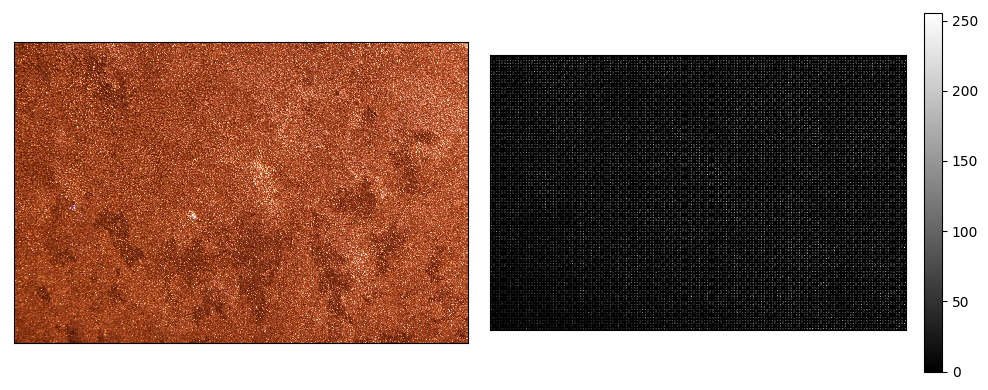

In [36]:
# Histogram of Oriented Gradients
plt.rcParams['image.cmap'] = 'gray'

def getHoG(img,shape=(8,8)):
    hog,vis = feature.hog(img,orientations=9,pixels_per_cell=shape,cells_per_block=(1,1),visualise=True,feature_vector=False,transform_sqrt=True)
    vis = skimage.exposure.rescale_intensity(vis,out_range=(0,255))
    vis = vis.astype("uint8")
    return np.mean(hog,axis=(2,3)),vis

#
def hogOne(im,d,thr,useMasked=True):
    shape = (d,d)
    
    if useMasked:
        hog,vis = getHoG(toGray(im.masked),shape=shape)
        return hog,vis
    
    hog,vis = getHoG(toGray(img))
    return hog,vis,img
    
#
def hogAll(group,d=8,thr=0.8,useMasked=True):
    hogs = []; viss = []
    
    for im in group:
        print(im.shape)
        hog,vis = hogOne(im,d,thr,useMasked=useMasked)
        hogs.append(hog); viss.append(vis)
        display(im.masked,vis)
        
    return hogs,viss

def hogPlot(data):
    wid = 20
    bins = np.arange(0,200,wid)
    cen = (bins[:-1]+bins[1:])/2
    
    fig,axes = plt.subplots(nrows=int(len(data)/4),ncols=4,figsize=(10,4))
    
    for ax,dat in zip(axes.flat,data):
        ax.bar(cen,dat,align='center',width=wid)

def convInd(ind,d):
    r,c = ind
    return r/8,c/8
    
def getRedHoG(img,mask,d,thr,hog,vis):
    redBlocks,redInds = getRedBlocks(img,mask,d,thr,useMasked=True)
    visblocks = skimage.util.view_as_blocks(vis,(d,d))
    maxr,maxc = hog.shape[0:2]
    redHoG = []; redvis = []
    for r,c in redInds:
        rr,cc = convInd((r,c),d)
        if rr < maxr and cc < maxc:
            redHoG.append(hog[rr,cc,:])
            redvis.append(visblocks[rr,cc,:,:])
        
    return redHoG,redvis

def getAllRedHoG(imgs,hogs,viss,d=8,thr=0.8):
    redHoGs = []; redVis = []
    for im,hog,vis in zip(imgs,hogs,viss):
        print(im.shape)
        mask = getRed(im)
        redHoG,redvis = getRedHoG(im,mask,d,thr,hog,vis)
        redHoGs.append(np.asarray(redHoG)); redVis.append(redvis)
        
    return redHoGs,redVis

d = 8
thr = 0.9
group = clf.pos
#group = clf.neg
#group = clf.test

%prun hogs,viss = hogAll(group,d,thr)

plt.tight_layout()
plt.show()

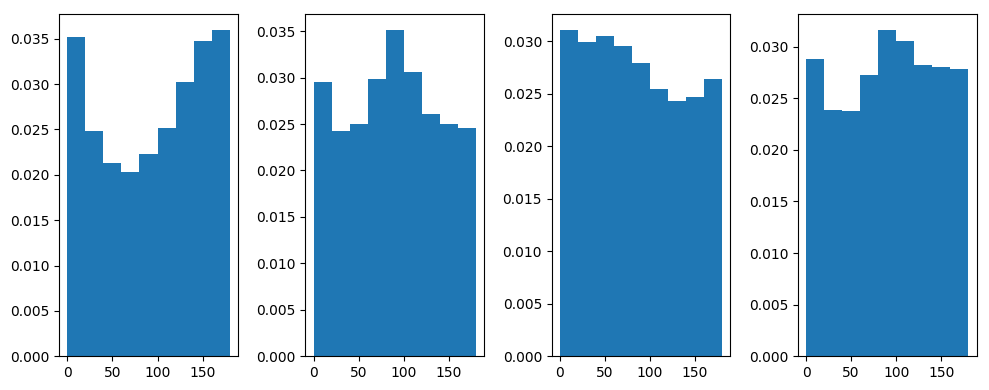

In [12]:
# More HoG

avg = []

for h in hogs:
    avg.append(np.mean(h,axis=(0,1)))

hogPlot(avg)


#%time redHoGs,redVis = getAllRedHoG(imgs,hogs,viss)

#start = 0
#num = 4
#end = start + num

#drawn = drawBlocks(skimage.color.gray2rgb(vis)data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAA90AAAGGCAYAAABmGOKbAAAABHNCSVQICAgIfAhkiAAAAAlwSFlzAAAPYQAAD2EBqD+naQAAIABJREFUeJzs3X+wXeV93/v3h1/ymAhcLgaZYEyT5oInJLURAYu2iW2iGQa7Hi4TBga39a2TMEqBQMCJUXOJgTDIjmdESOgkNkOwSWzAhFb1Lb4oIzcm40EWAQKGGFzaRrXBFh7AIAJFitH3/rHWhsXm7CPtw1k6Z+/zfs2sOdrP+q5nPQuxdPZ3Pet5nlQVkiRJkiRp/u2z0A2QJEmSJGlamXRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk/2W+gG7C1JAhwBPL/QbZHmwXLge1VVC92QheR9rSnjfd3y3tYU8b5ueV9ryox1by+ZpJvmJn98oRshzaMjgScWuhELzPta08b7uuG9rWnifd3wvta02eN7eykl3c8DfPe73+Wggw5a6LZIc7Z9+3be/va3g0+KwftaU8L7+nW8tzXxvK9fx/taU2Eu9/ZSSroBOOigg7zRpSnjfS1NJ+9tafp4X2spciI1SZIkSZJ6YtItSZIkSVJPTLolSZIkSeqJSbckSZIkST0x6ZYkSZIkqScm3ZIkSZIk9cSkW5IkSZKknph0S5IkSZLUE5NuSZIkSZJ6YtItSZIkSVJPTLolAZDkvCRbk7yUZEuSE3cTf2aSR9v4h5KcNrT/8nb/C0l+mGRTkpOGYrYmqaHt0j6uT5IkSVoIJt2SSHIWsB64AjgeeBDYmOSwEfEnAzcDNwDvBjYAG5Ic1wn7b8D5wM8A/xzYCvxFkrcOVfc7wNs62x/Oz1VJkiRJC8+kWxLAxcD1VXVjVX0LWAO8CHx0RPyFwJ1V9emqeqSqLgPup0myAaiqL1bVpqr6n1X1t+05DgJ+dqiu56tqW2d7Yb4vTpIkSVoo+y10A6RpcvSld8xLPVs/+YF5qWdPJDkAWAmsG5RV1a4km4BVIw5bRdMz3rUROH2Wc5wLPEfTi951aZLLgO8AXwSuqaofjahnGbCsU7R8RPs0hkn8/1by/1tJS43/7k0uk25JhwL7Ak8OlT8JHDvimBUj4ld0C5J8ELgFeDPwfWB1VT3VCfkDmh7yZ4CTaRL/t9H0is9kLfCJWa5FkiRJWlRMuiX16S+Bd9Ek9r8KfCnJSVX1A4Cq6vaWfzPJTuAzSdZW1Y4Z6lvHa3vYlwOP99N0SZIk6Y1zTLekp4CXgcOHyg8Hto04ZtuexFfVC1X136vqG1X1y8CPgF+epS1baB4GHj3TzqraUVXbBxvw/Cx1SZIkSQtuTkm3SwtJ06OqdgL3AacMypLs037ePOKwzd341upZ4gf24bVjsoe9C9gF/GA39UiSJEkTYeyk26WFpKm0HvjVJB9J8k7gj4ADgRsBktyUZF0n/lrg1CSXJDk2yeXACcB1bfyBSa5O8p4k70iyMsmfAD8O3NbGrEpyUZJ/muQnknwYuAb4s6r64V66bkmSJKlXcxnT/crSQgBJ1gAfoFla6JMzxL+ytFD7+bIkq2mS7DXQLC3UPSDJxTSvoP4s8NXOrueratTrrpLmqKpubR9yXUkzGdoDwKlVNZgs7SiaHuhB/N1JzgGuAq4GHgNOr6qH25CXaSZh+wjNeO6ngb8G/kW7fBjADuBs4HKa3u+/o0m6h2dFl6RFz1mFJUmjjJV0T9LSQnPhL0wtZVV1HW1P9Qz73jtD2W20vdYz7HsJOGM357sfeM/YDZU0liTnAb9J80DtQeCCqrpnlvgzgd+lmVvhMeDjVfWVzv7LaR6YvR0YDE/57ara0ok5hOZttH9J88DuduDCqvr7+bw2SZImwbivl8+2tNCK14cDYywtlOTvgZeA32DmpYXOBt4HfAb498DvjWpokmVJDhpsuJ6vJGmJWcAhYV8AfppmrocPAj8PfHbeLkySpAmymGYvHywtdDJwJ83SQq98Kaiq9VX1tar6ZlX9MXAJcEGSUZMyraXpLR9sLiskSVpqXhkSVlXfohnW9SLNkLCZvDIkrKoeqarLgPtpkmygGRJWVZuq6n+2w0UuBg6iGRJGOy/EqcCvVNWWqvo6cAFwdpIjerpOSZIWrXGT7olZWojmFfiDO9uRs9QlSdJU6QwJ2zQoq6pd7efZhoRtGirbOCp+xJCwVcCzVXVvJ3QTzWvmJzED306TJE2zscZ0V9XOJIOlhTbAa5YWmnEsKK8uLfT7nbLelxaqqh00EzXRtnM3p9NSNl/j+SVpEZltSNixI47Z4yFhwC3Am4Hv89ohYSsY+t1cVT9K8sxwPR1rgU+MvBJJ0rxxHqu9by6zl68HPp/kXuAe4CKGlhYCnqiqtW38tcBdSS4B7qAZl30CzZNxkhwI/DbwZZpf3IcC5zG0tBDN0/G/BJ6neYru0kKSJC2MwZCwQ4FfpRkSdlJVzfggfA+s47WTri5nLw0L86GrJpETJEqTZewx3VV1K/AxmqWFHqD5pTu8tNDbOvF3A+fQJNkPAr/EzEsL3U4zOcv/C/wfzLy00F3A39Ik6de0dUqSpNdbqCFh24DXTNSWZD/gkFHnraodVbV9sNE8YJc0AydIlCbPXHq6XVpIkqRFbgGHhG0G3pJkZVXd15a9v43ZMtPBksbyygSJAEnWAB+gmSDxkzPEvzJBYvv5siSraZLsNdBMkNg9IMnFNA/Sfhb4ameCxJ8bzNeQ5ALgK0k+VlXfm+drlKbKYpq9XJIkza/1wK8m+Uj7pfmPGBoSlmRdJ/5a4NQklyQ5tn3l9ATaJD3JgUmuTvKeJO9IsjLJn9AZElZVj9CsQnJ9khOT/LP2+Fv8Yi69MZM0QaKkV82pp1uSJC1+VXVr+3rolTRjPx/g9UPCdnXi705yDnAVcDXN2M+ZhoR9hGY899PAX/PaIWEAH6ZJtL/Kq2M/f72Xi5wyTnCk3ZiYCRLbZX27kyK7KoGWLJNuSZKm2N4eEtbGPUMzn4ukyTHfEyS6KoHU8vVySZIkaTJMzASJNKsSHNzZjhwRJ009k25JkiRpAlTVYDmvUwZlnQkSR014uLkb35rzBImd/bNOkOiqBNKrfL1ckiRJmhzrgc8nuRe4B7iIoQkSgSeqam0bfy1wV5JLgDtoluE9gXbp3SQH0izH+2WasdyHAucxNEFiksEEiWuA/XGCRGmPmXRLkiRJE8IJEqXJY9ItSZIkTRAnSJQmi2O6JUmSJEnqiUm3JEmSJEk9MemWJEmSJKknJt2SJEmSJPXEpFuSJEmSpJ6YdEuSJEmS1BOXDJMkSZK04I6+9I55qWfrJz8wL/VI88WebkmSJEmSemLSLUmSJElST0y6JUmSJEnqiWO6JUmSpoxjYyVp8bCnW5IkSZKkntjTLUmSJEkai2/U7Dl7uiVJkiRJ6ok93ZIkSZKkBbEUeszt6ZYkSZIkqSf2dEuSJEmSJtpi7jG3p1uSJEmSpJ6YdEuSJEmS1BNfL5ckzYvF/FqXJEnSQrGnWxIASc5LsjXJS0m2JDlxN/FnJnm0jX8oyWlD+y9v97+Q5IdJNiU5aSjmkCRfSLI9ybNJbkjyY31cnyRJkrQQTLolkeQsYD1wBXA88CCwMclhI+JPBm4GbgDeDWwANiQ5rhP234DzgZ8B/jmwFfiLJG/txHwB+GlgNfBB4OeBz87bhUmSJEkLzNfLJQFcDFxfVTcCJFkDfAD4KPDJGeIvBO6sqk+3ny9LspomyV4DUFVf7B6Q5GLgl4GfBb6a5J3AqcDPVdW9bcwFwFeSfKyqvjfP1yhJkrTXzdfwK00ue7qlJS7JAcBKYNOgrKp2tZ9XjThsVTe+tXFUfHuOc4HnaHrRB3U8O0i4W5uAXcBJSJIkSVPAnm5JhwL7Ak8OlT8JHDvimBUj4ld0C5J8ELgFeDPwfWB1VT3VqeMH3fiq+lGSZ4br6dS3DFjWKVo+on2SJEnSomBPt6Q+/SXwLuBk4E7gS6PGie+htTS95YPt8TfcQkmSJKlH9nRLegp4GTh8qPxwYNuIY7btSXxVvQD893b7RpLHaMZ1r2tjX5OAJ9kPOGSW866jmfBtYDlLOPF2jJgkzY1LHEram+bU0+3SQtL0qKqdwH3AKYOyJPu0nzePOGxzN761epb4gX149fXwzcBbkqzs7H9/G7NlRFt3VNX2wQY8v5vzSZIkSQtq7KTbpYWkqbQe+NUkH2lnFf8j4EBgMJv5TUnWdeKvBU5NckmSY5NcDpwAXNfGH5jk6iTvSfKOJCuT/Anw48BtAFX1CM0r59cnOTHJP2uPv8WZyyVJkjQt5vJ6uUsLadHw9dr5UVW3tg+5rqSZxOwB4NSqGkyWdhTNrOKD+LuTnANcBVwNPAacXlUPtyEv00zC9hGaidqeBv4a+BdV9bedU3+YJtH+alv/7cCvz/f1+RqhJEmSFspYSXdnaaFXeryqaleS3S0ttH6obCNw+iznGHdpof80Qz3OciyNoaquo+2pnmHfe2cou42213qGfS8BZ+zBOZ8BzhmroZIkSdIEGff18tmWFppxiR/GWFooyd8DLwG/wR4sLQSMXFoIZzmWJEmSJC2wxbRk2HwvLbQOOLizHfmGWyhJkiRJ0hjGTbp7XVqoqv57VX2jqn4Z+BHNuO5BHWMtLeQsx5IkSZKkhTZW0j1JSwtJkiRJkrTQ5jJ7+Xrg80nuBe4BLmJoaSHgiapa28ZfC9yV5BLgDuBsmqWFzm3jDwR+G/gy8H2acePnMbS0UJLB0kJrgP1xaSFJkiRJ0iI3dtI97UsLSZI0TZKcB/wmze/sB4ELquqeWeLPBH4XOJrmd/bHq+or7b79aX6fnwb8BM1EpZuAS7sPwZNsBd4xVPXaqpppaVEtYi65KElv3Fx6ul1aSJKkCZDkLJo31NbQDMe6CNiY5Jiq+sEM8ScDN9OsAPJfaH7vbkhyfPuw/M3A8TRJ+YPAP6J5o+3LNG+xdf0OcH3ns3OrSJKWpMU0e7kkSZpfFwPXV9WNVfUtmuT7ReCjI+IvBO6sqk9X1SNVdRlwP3A+QFU9V1Wrq+pLVfXtqvpGu29lkqOG6nq+qrZ1thd6uUJJkhY5k25JkqZQkgOAlTSvfwNQVbvaz6tGHLaqG9/aOEs8NMtyFvDsUPmlSZ5O8jdJfrNddUSSpCXHX4CSJE2nQ4F9gSeHyp+kmUtlJitGxK+YKTjJm4BPATe3y3MO/AFND/kzwMnAOuBtND3vM9WzjFdXLAFYPqJ9kiRNHHu6JUnS2NpJ1b4EBPi17r6qWl9VX6uqb1bVHwOXABe0yfVM1tJMyjbYHu+v5dLkS3Jekq1JXkqyJcmJu4k/M8mjbfxDSU7r7Ns/yafa8heSfC/JTUmOGKpja5Ia2i7t6xqlaWLSLUnSdHqKZoWQw4fKDwe2jThm257EdxLudwCrh3q5Z7KF5u26o0fsX0fzmvpgO3I39UlLVmeCxCtoJjZ8kGaCxMNGxA8mSLwBeDewgWaCxOPakO4EicfTTHB8DM0EicN+h+atlcH2h/NzVdJ0M+mWJGkKVdVO4D7glEFZkn3az5tHHLa5G99a3Y3vJNw/BfxiVT29B815F81yn6+bMb1t646q2j7YcKZzaTZOkChNGMd0S5I0vdYDn09yL3APzZJhBwI3AiS5CXiiqta28dcCdyW5BLgDOJtmKbBz2/j9gT+n6Q37ILBvksF472eqameSVcBJwF/SJM+rgGuAP6uqH/Z8vZpy87Vu+KTqTJC4blBWVbuS7G6CxPVDZRuB02c51WwTJF4GfAf4InBNVf1oRFudq0FqmXRLkjSlqurWJG8FrqSZDO0B4NSqGkyWdhRND/Qg/u4k5wBXAVcDjwGnt2t0A/w48KH2zw8Mne59wNeAHTTJ+uU0X7j/jibpHv7SL2l8EzNBIs1cDZ8YsU9aUky6JUmaYlV1HXDdiH3vnaHsNuC2EfFbaSZOm+189wPvGbedkhbe7iZI7Hz8ZpKdwGeSrK2qHTNUt47XPmxbjpMkaoky6ZYkSZImw96aIPH9Y06Q+O3hnW0i/koynsz6vE6aaibdkiRJ6tVSH4s9X9p5EwYTJG6A10yQOOMbLbw6QeLvd8pmmyDxffMxQaKkV5l0S5IkSZPDCRKlCWPSLUmSJE0IJ0iUJo9JtyRJkjRBnCBRmiz7LHQDJEmSJEmaVibdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknri7OWSJEmSpsbRl94xL/Vs/eQH5qUeyaRbkiRJkobMV/Iu+Xq5JEmSJEk9MemWJEmSJKknvl4uSVpUHIsnSZKmiT3dkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiUBkOS8JFuTvJRkS5ITdxN/ZpJH2/iHkpzW2bd/kk+15S8k+V6Sm5IcMVTH1iQ1tF3a1zVKkiRJe5tJtySSnAWsB64AjgceBDYmOWxE/MnAzcANwLuBDcCGJMe1IW9u6/nd9ucZwDHAl2eo7neAt3W2P5yfq5IkSZIWnkm3JICLgeur6saq+hawBngR+OiI+AuBO6vq01X1SFVdBtwPnA9QVc9V1eqq+lJVfbuqvtHuW5nkqKG6nq+qbZ3thV6uUJIkSVoAJt3SEpfkAGAlsGlQVlW72s+rRhy2qhvf2jhLPMDBQAHPDpVfmuTpJH+T5DeT7DdLW5clOWiwActnOZ8kSZK04EZ+uZW0ZBwK7As8OVT+JHDsiGNWjIhfMVNwkjcBnwJurqrtnV1/QNND/gxwMrCO5hXzi0ecdy3wiRH7JsbRl96x0E1YEubrv/PWT35gXuqRJElL05x6up1wSdKeSrI/8CUgwK9191XV+qr6WlV9s6r+GLgEuCDJshHVraPpMR9sR/bXckmSJOmNGzvpdsIlaeo8BbwMHD5UfjiwbcQx2/YkvpNwvwNYPdTLPZMtNG/gHD3TzqraUVXbBxvw/G7qkyRJkhbUXHq6nXBJmiJVtRO4DzhlUJZkn/bz5hGHbe7Gt1Z34zsJ908Bv1hVT+9Bc94F7AJ+sKftlyRJkhazscZ0dyZcWjcoq6pdSXY34dL6obKNwOmznGq2CZcuA74DfBG4pqp+NKKty4DuK6pOuLSIOKZ10VkPfD7JvcA9wEXAgcCNAEluAp6oqrVt/LXAXUkuAe4AzgZOAM5t4/cH/pzm7ZUPAvsmGYz3fqaqdiZZBZwE/CVNj/Uq4Brgz6rqhz1fr7THHBsuSZLeiHEnUnPCJWkKVdWtSd4KXElzbz4AnFpVg3v3KJoe6EH83UnOAa4CrgYeA06vqofbkB8HPtT++YGh070P+BqwgyZZv5zmAdnf0STdww/pJEmSpIm1qGYv392ES52P30yyE/hMkrVVtWOG6tbx2i/vy4HH57nJ0tSoquuA60bse+8MZbcBt42I30pzH892vvuB94zbTkmSJGmSjJt0760Jl94/5oRL3x7e2SbiryTjyazf/+eVryJK08lhEZIkSRrXWBOpOeGSJEmSJEl7bi6vlzvhkiRJkiRJe2DspNsJlyRJkiRJ2jNzmkjNCZckSZIkSdq9scZ0S5IkSZKkPWfSLUmSJElST0y6JUmSJEnqiUm3JEmSJEk9MemWJEmSJKknJt2SJEmSJPXEpFuSpCmW5LwkW5O8lGRLkhN3E39mkkfb+IeSnNbZt3+ST7XlLyT5XpKbkhwxVMchSb6QZHuSZ5PckOTH+rpGSZIWM5NuSZKmVJKzgPXAFcDxwIPAxiSHjYg/GbgZuAF4N7AB2JDkuDbkzW09v9v+PAM4BvjyUFVfAH4aWA18EPh54LPzdmGSJE0Qk25JkqbXxcD1VXVjVX0LWAO8CHx0RPyFwJ1V9emqeqSqLgPuB84HqKrnqmp1VX2pqr5dVd9o961MchRAkncCpwK/UlVbqurrwAXA2cM94pIkLQUm3ZIkTaEkBwArgU2Dsqra1X5eNeKwVd341sZZ4gEOBgp4tlPHs1V1bydmE7ALOGlEW5clOWiwActnOZ+05DlsRJosJt2SJE2nQ4F9gSeHyp8EVow4ZsU48UneBHwKuLmqtnfq+EE3rqp+BDwzy3nXAs91tsdHxElLnsNGpMlj0i1JksaWZH/gS0CAX3uD1a2j6TEfbEe+wfqkaeawEWnCmHRLkjSdngJeBg4fKj8c2DbimG17Et9JuN8BrO70cg/qOGwofj/gkFHnraodVbV9sAHPj7ooaSmbpGEjkl5l0i1J0hSqqp3AfcApg7Ik+7SfN484bHM3vrW6G99JuH8K+MWqenqGOt6SZGWn7P003zm2jH8lkjomZtiIczVIr9pvoRsgSZJ6sx74fJJ7gXuAi4ADgRsBktwEPFFVa9v4a4G7klwC3AGcDZwAnNvG7w/8Oc24zw8C+yYZfOF+pqp2VtUjSe4Erk+yBtgfuA64paq+1/sVS5qzeR42shb4xBtulDQFTLolSZpSVXVrkrcCV9L0Rj0AnFpVg16vo2heDx3E353kHOAq4GrgMeD0qnq4Dflx4EPtnx8YOt37gK+1f/4wTaL91bb+24Ffn78rk5asvTVs5P1vdNgIzVwN6zufl+MkiVqiTLolSZpiVXUdTQI80773zlB2G3DbiPitND1guzvnM8A547RT0u5V1c4kg2EjG+A1w0ZmvM95ddjI73fKZhs28r7Zho1U1X1t2azDRqpqB7Cjc449uURpKpl0S5IkSZPDYSPShDHp1h47+tI7FroJkiRJS5rDRqTJY9ItSZIkTRCHjUiTxSXDJEmSJEnqiUm3JEmSJEk9MemWJEmSJKknJt2SJEmSJPXEpFuSJEmSpJ6YdEuSJEmS1BOTbkmSJEmSeuI63YvY0ZfeMS/1bP3kB+alHkmSJEnSeOzpliRJkiSpJybdkiRJkiT1xKRbEgBJzkuyNclLSbYkOXE38WcmebSNfyjJaZ19+yf5VFv+QpLvJbkpyRFDdRyS5AtJtid5NskNSX6sr2uUJEmS9jaTbkkkOQtYD1wBHA88CGxMctiI+JOBm4EbgHcDG4ANSY5rQ97c1vO77c8zgGOALw9V9QXgp4HVwAeBnwc+O28XJkmSJC0wk25JABcD11fVjVX1LWAN8CLw0RHxFwJ3VtWnq+qRqroMuB84H6Cqnquq1VX1par6dlV9o923MslRAEneCZwK/EpVbamqrwMXAGcP94hLkiRJk8qkW1rikhwArAQ2Dcqqalf7edWIw1Z141sbZ4kHOBgo4NlOHc9W1b2dmE3ALuCkEW1dluSgwQYsn+V8kiRJ0oKbU9Lt2E9pqhwK7As8OVT+JLBixDErxolP8ibgU8DNVbW9U8cPunFV9SPgmVnOuxZ4rrM9PiJOkiRJWhTGTrod+ylpHEn2B74EBPi1N1jdOpoe88F25BusT5IkSerVfnM45pWxnwBJ1gAfoBn7+ckZ4l8Z+9l+vizJaprxnWuq6jmaRPoVSc4H7klyVFV9pzP28+cGr6ImuQD4SpKPVdX35nAdS8bRl96x0E3Q4vYU8DJw+FD54cC2Ecds25P4TsL9DuD9nV7uQR2HDcXvBxwy6rxVtQPY0Ykf0TxJkiRpcRirp3uSxn5K2jNVtRO4DzhlUJZkn/bz5hGHbe7Gt1Z34zsJ908Bv1hVT89Qx1uSrOyUvZ/m36Ut41+JJEmStPiM29M929jPY0cc09vYzyQjx34mWQYs6xQ54ZI02nrg80nuBe4BLgIOBAZvtNwEPFFVa9v4a4G7klwC3AGcDZwAnNvG7w/8Oc2QkQ8C+yYZ3KvPVNXOqnokyZ3A9e0bM/sD1wG3+PaKJEmSpsVcXi/vzTyP/VwLfOINN0paAqrq1iRvBa6keZD1AHBqVQ0emB1F82bJIP7uJOcAVwFXA48Bp1fVw23IjwMfav/8wNDp3gd8rf3zh2kS7a+29d8O/Pr8XZkkSZK0sMZNuidm7CfNhEvrO5+X40zH0khVdR1NAjzTvvfOUHYbcNuI+K00D892d85ngHPGaackSZI0ScYa0z1JYz+rakdVbR9swPO7uTxJkiRJkubVXF4vd+ynJEmSJEl7YOyk27GfkiRJkiTtmTlNpObYT0mSJEmSdm+sMd2SJEmSJGnPmXRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJUyrJeUm2JnkpyZYkJ+4m/swkj7bxDyU5bWj/GUn+IsnTSSrJu2ao42vtvu72x/N9bZIkTQqTbkmSplCSs4D1wBXA8cCDwMYkh42IPxm4GbgBeDewAdiQ5LhO2IHA14GP7+b01wNv62y/NfcrkSRpsu230A2QJEm9uBi4vqpuBEiyBvgA8FHgkzPEXwjcWVWfbj9flmQ1cD6wBqCq/rSt6+jdnPvFqtr2Ri9AkqRpYE+3JElTJskBwEpg06Csqna1n1eNOGxVN761cZb42Xw4yVNJHk6yLsmb51CHpBEcOiJNFpNuSZKmz6HAvsCTQ+VPAitGHLNizPhRvgj8K+B9wDrgXwN/NtsBSZYlOWiwAcvHPKe0ZDh0RJo8vl4uSZLmTVV9tvPxoSTfB76a5Cer6n+MOGwt8In+WydNBYeOSBPGnm5JkqbPU8DLwOFD5YcDo74wbxszfk9taX/+k1li1gEHd7Yj3+A5pak0SUNHfINFepVJtyRJU6aqdgL3AacMypLs037ePOKwzd341upZ4vfUYGzo90cFVNWOqto+2IDn3+A5pWk1SUNH1gLPdbbHxzyfNDV8vVySpOm0Hvh8knuBe4CLaMZtDl5JvQl4oqrWtvHXAncluQS4AzgbOAE4d1BhkkOAo4Aj2qJjkgBsq6ptSX4SOAf4CvA08LPANcBfVdU3e7xWST2bw9CRdTT/Dg0sx8RbS5RJtyQ880piAAAaXUlEQVRJU6iqbk3yVuBKmh6tB4BTq2rQ43UUsKsTf3eSc4CrgKuBx4DTq+rhTrUfok3aW7e0P68ALgd2Ar/Iqwn+d4Hb2zolvXGLdejI65LuqtoB7Bh8bh/QSUuSSbckSVOqqq4Drhux770zlN0G3DZLfZ8DPjfL/u8CvzBmMyXtoaramWQwdGQDvGboyIz3Oq8OHfn9TtleGToiqWHSLUmSJE0Oh45IE8akW5IkSZoQDh2RJo9JtyRJkjRBHDoiTRaXDJMkSZIkqScm3ZIkSZIk9cSkW5IkSZKknph0S5IkSZLUE5NuSQAkOS/J1iQvJdmS5MTdxJ+Z5NE2/qEkpw3tPyPJXyR5OkkledcMdXyt3dfd/ni+r02SJElaKCbdkkhyFs26n1cAxwMPAhuTHDYi/mTgZuAG4N3ABmBDkuM6YQcCXwc+vpvTXw+8rbP91tyvRJIkSVpcXDJMEsDFwPVVdSNAkjXAB4CPAp+cIf5C4M6q+nT7+bIkq4HzgTUAVfWnbV1H7+bcL1bVtjd6AZIkSdJiZE+3tMQlOQBYCWwalFXVrvbzqhGHrerGtzbOEj+bDyd5KsnDSdYlefMc6pAkSZIWpTkl3Y79lKbKocC+wJND5U8CK0Ycs2LM+FG+CPwr4H3AOuBfA382KjjJsiQHDTZg+ZjnkyRJkvaqsZNux35Kmi9V9dmq2lhVD1XVF4B/A/xfSX5yxCFrgec62+N7qamSJEnSnMylp/uVsZ9V9S2a8Zsv0oz9nMkrYz+r6pGqugy4n2bsJ9CM/ayqK3n966rDXqyqbZ1t+xzaL+m1ngJeBg4fKj8cGDXWetuY8XtqS/vzn4zYvw44uLMd+QbPJ0mSJPVqrKR7ksZ++hqqtGeqaidwH3DKoCzJPu3nzSMO29yNb62eJX5PDYaWfH+mnVW1o6q2Dzbg+Td4PkmSJKlX485ePtvYz2NHHDOfYz//F/A94GeBTwHHAGeMiF8LfGLMc0hL1Xrg80nuBe4BLqIZ9jGYzfwm4ImqWtvGXwvcleQS4A7gbOAE4NxBhUkOAY4CjmiLjkkCsK2qtrWvkJ8DfAV4mua+vgb4q6r6Zo/XKkmSJO01E7NkWFV9tvPxoSTfB76a5Cer6n/McMg6mkRiYDmO/5RmVFW3JnkrcCXNA7EHgFOravDA7ChgVyf+7iTnAFcBVwOPAadX1cOdaj9Em7S3bml/XgFcDuwEfpFXE/zvAre3dUqSJElTYdyke7GO/Xxd0l1VO4Adg89tD5ukEarqOuC6EfveO0PZbcBts9T3OeBzs+z/LvALYzZTkiRJmihjjemepLGfkiRJkiQttLm8Xu7YT0mSJEmS9sDYSbdjPyVJkiRJ2jNzmkjNsZ+SJEmSJO3eWGO6JUmSJEnSnjPpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkjSlkpyXZGuSl5JsSXLibuLPTPJoG/9QktOG9p+R5C+SPJ2kkrxrhjrelOQ/tDF/n+T2JIfP97VJkjQpTLolSZpCSc4C1gNXAMcDDwIbkxw2Iv5k4GbgBuDdwAZgQ5LjOmEHAl8HPj7Lqa8B/iVwJvALwBHAf3xDFyNJ0gQz6ZYkaTpdDFxfVTdW1beANcCLwEdHxF8I3FlVn66qR6rqMuB+4PxBQFX9aVVdCWyaqYIkBwO/DFxcVf+1qu4D/i1wcpL3zNuVSUucb7FIk8WkW5KkKZPkAGAlneS4qna1n1eNOGwVr0+mN84SP5OVwP5D530U+M5s9SRZluSgwQYsH+Oc0pLiWyzS5DHpliRp+hwK7As8OVT+JLBixDErxowfVcfOqnp2zHrWAs91tsfHOKe01PgWizRhTLolSdJCWwcc3NmOXNjmSIvTJL3F4hss0qtMuiVJmj5PAS8Dw+MtDwe2jThm25jxo+o4IMlbxqmnqnZU1fbBBjw/xjmlpWSS3mLxDRapZdItSdKUqaqdwH3AKYOyJPu0nzePOGxzN761epb4mdwH/MPQeY8BjhqzHkmTzzdYpNZ+C90ASZLUi/XA55PcC9wDXEQzWdKNAEluAp6oqrVt/LXAXUkuAe4AzgZOAM4dVJjkEJoE+oi26JgkANuqaltVPZfkBmB9kmeA7cAfApur6hu9Xq20NCz4WyxDvd0j66mqHcCOwef23wppSbKnW5KkKVRVtwIfA64EHgDeBZxaVYPXTI8C3taJvxs4hybJfhD4JeD0qnq4U+2HgL+hScoBbmk/r+nE/AbwX4Dbgb+i+UJ+xnxem7RU+RaLNJns6ZYkaUpV1XXAdSP2vXeGstuA22ap73PA53ZzzpeA89pN0vzzLRZpwph0S5IkSROiqm5N8laat1hW0LzJMvwWy65O/N1JzgGuAq4GHmPmt1hu7Hy+pf15BXB5++ffaOu9HVhGMwP6v5u/K5Oml6+XSwIgyXlJtiZ5KcmWJCfuJv7MJI+28Q8lOW1o/xlJ/iLJ00kqybtmqONNSf5DG/P3SW5PMjzuTJIkdVTVdVX1jqpaVlUnVdWWzr73VtX/PRR/W1Ud08YfV1VfGdr/uarKDNvlnZiXquq8qjqkqg6sqjOqapxx4dKSZdItiSRn0byudgVwPM14zo1JDhsRfzJwM3AD8G5gA7AhyXGdsAOBrwMfn+XU1wD/EjgT+AWa19r+4xu6GEmSJGkRmVPSbY+YNHUuBq6vqhur6ls0kyK9CHx0RPyFwJ1V9emqeqSqLgPuB84fBFTVn1bVlcCmmSpIcjDwy8DFVfVfq+o+4N8CJyd5z7xdmSRJkrSAxk667RGTpkuSA4CVdJLjqtrVfl414rBVvD6Z3jhL/ExWAvsPnfdR4Duj6kmyLMlBgw1YPsb5JEmSpL1uLj3d9ohJ0+VQYF/gyaHyJ2kmaJnJijHjR9Wxc2i9z93VsxZ4rrM9Psb5JEmSpL1urKR7knrEJE2ldcDBne3IhW2OJEmSNLtxlwybrUfs2BHHLEiPWJJlNMsZDPgaqjSzp4CXgeE5Eg4HRs1Kum3M+FF1HJDkLUP39sh6qmoHsGPwuV1DVJIkSVq0pnn2cl9DlfZAVe0E7gNOGZQl2af9vHnEYZu78a3Vs8TP5D7gH4bOewzN+qLj1CNJkiQtWuP2dE9MjxjNa6jrO5+XY+ItjbIe+HySe4F7gItoJji8ESDJTcATVbW2jb8WuCvJJcAdwNnACcC5gwqTHEKTQB/RFh3T9kxvq6ptVfVckhuA9UmeAbYDfwhsrqpv9Hq1kiRJ0l4yVk/3JPWIVdWOqto+2IDnxziftKRU1a3Ax4ArgQeAdwGnVtVgaMhRwNs68XcD59Ak2Q8CvwScXlUPd6r9EPA3NEk5wC3t5zWdmN8A/gtwO/BXNA/RzpjPa5MkSZIW0rg93WCPmDSVquo64LoR+947Q9ltwG2z1Pc54HO7OedLwHntJkmSJE2dsZPuqro1yVtpesRW0PSKDfeI7erE353kHOAq4GrgMWbuEbux8/mW9ucVwOXtn3+jrfd2mgnSNgL/btz2S5IkSZK0t8ylp9seMUmSJEmS9sA0z14uSZIkSdKCMumWJEmSJKknJt2SJEmSJPXEpFuSJEmSpJ6YdEuSJEmS1BOTbkmSJEmSemLSLUmSJElST0y6JUmSJEnqiUm3JEmSJEk9MemWJEmSJKknJt2SJEmSJPXEpFuSJEmSpJ6YdEuSJEmS1BOTbkmSJEmSemLSLUmSJElST0y6JUmSJEnqiUm3JEmSJEk9MemWJEmSJKknJt2SJEmSJPXEpFuSJEmSpJ6YdEuSJEmS1BOTbkmSJEmSemLSLUmSJElST0y6JUmSJEnqiUm3JEmSJEk9MemWJEmSJKknJt2SJEmSJPXEpFuSpCmW5LwkW5O8lGRLkhN3E39mkkfb+IeSnDa0P0muTPL9JP87yaYkPzUUszVJDW2X9nF9kiQtdibdkiRNqSRnAeuBK4DjgQeBjUkOGxF/MnAzcAPwbmADsCHJcZ2w3wJ+HVgDnAS80Nb5pqHqfgd4W2f7w3m6LGnJ82GaNFlMuiVJml4XA9dX1Y1V9S2aRPlF4KMj4i8E7qyqT1fVI1V1GXA/cD40X8yBi4Crquo/V9U3gX8DHAGcPlTX81W1rbO9MP+XJy09PkyTJo9JtyRJUyjJAcBKYNOgrKp2tZ9XjThsVTe+tbET/4+BFUN1PgdsmaHOS5M8neRvkvxmkv3mei2SXsOHadKEMemWJGk6HQrsCzw5VP4kTeI8kxW7iV/RKZutzj8AzgbeB3wG+PfA741qaJJlSQ4abMDyUbHSUubDNGkyeaNIkqR5VVXrOx+/mWQn8Jkka6tqxwyHrAU+sXdaJ0202R6mHTvimPl8mHY/8AxwMrCO5hXzi2c6aZJlwLJOkQ/TtGTZ0y0JcFIWaQo9BbwMHD5UfjiwbcQx23YTv61Ttqd1QtNjth9w9Ij964CDO9uRs9QlaQFU1fqq+lpVfbOq/hi4BLigTa5nshZ4rrM9vpeaKi06c0q6/XIuTRcnZZGmT1XtBO4DThmUJdmn/bx5xGGbu/Gt1Z34v6NJrrt1HkRzj4+qE+BdwC7gByPauqOqtg824PlZ6pKWMh+mSRNo7KTbL+fSVHJSFmk6rQd+NclHkrwT+CPgQOBGgCQ3JVnXib8WODXJJUmOTXI5cAJwHUBVFfD7wP+T5ENJfga4Cfgeze93kqxKclGSf5rkJ5J8GLgG+LOq+uHeuGhpWvkwTZpMc+np9su5NEWclEWaXlV1K/Ax4ErgAZovyadW1WDs5lE0D7EH8XcD5wDn0jxU/yXg9Kp6uFPt79E89P4s8NfAj7V1vtTu30EzidpdwN8Cv02TdJ/bwyVKS5EP06QJM9aX286X81du5KralWR3X87XD5Vt5NWEesYv50kGX85v6Rx3aZLLgO8AXwSuqaofjXMNkl7HSVmkKVZV19F+uZ5h33tnKLsNuG2W+ormzbPfGbH/fuA9c2mrpN2rqluTvJXmYdoKmgdqww/TdnXi705yDnAVcDXwGDM/TDuQ5mHaW4CvM/PDtMtpfg//HU3SPfwdX9IMxu1R8su5pHnjDMeSJI3Ph2nSZJmY2cudMVHqjZOySJIkST0ZN+n2y7k0ZZyURZIkSerPWEm3X86lqeWkLJIkSVIP5jJL8Hrg80nuBe6hmXn8NV/OgSeqam0bfy1wV5JLgDtoJmE4gXYW06qqJIMv54/RJOG/y9CXc5ok/C9pkudV+OVcmjdOyiJJkiT1Y+yk2y/n0nRyUhZJkiRp/s1pPVy/nEuSJEmStHsTM3u5JEmSJEmTxqRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktQTk25JkiRJknpi0i1JkiRJUk9MuiVJkiRJ6olJtyRJkiRJPTHpliRJkiSpJybdkiRJkiT1xKRbkiRJkqSemHRLkiRJktSTOSXdSc5LsjXJS0m2JDlxN/FnJnm0jX8oyWlD+5PkyiTfT/K/k2xK8lNDMYck+UKS7UmeTXJDkh+bS/slvZ73tTSdvLel6eN9LU2WsZPuJGcB64ErgOOBB4GNSQ4bEX8ycDNwA/BuYAOwIclxnbDfAn4dWAOcBLzQ1vmmTswXgJ8GVgMfBH4e+Oy47Zf0et7X0nTy3pamj/e1NHnm0tN9MXB9Vd1YVd+iuTlfBD46Iv5C4M6q+nRVPVJVlwH3A+dD82QNuAi4qqr+c1V9E/g3wBHA6W3MO4FTgV+pqi1V9XXgAuDsJEfM4RokvZb3tTSdvLel6eN9LU2Y/cYJTnIAsBJYNyirql1JNgGrRhy2iuZpXNdG2psY+MfACmBTp87nkmxpj72l/flsVd3bqWMTsIvmadx/mqGty4BlnaLlANu3bx95fbt2vDhyn7Q3zfb/6Wz75mLa72vw3tbisDfva5j+e9v7WouB97X3tabP7u7dudzbYyXdwKHAvsCTQ+VPAseOOGbFiPgVnf3sQcwPujur6kdJnunEDFsLfGK48O1vf/uIcGnxOPj39yhsOTAfv9G9r6W9YC/f1+C9LfXO+9r7WtNnD+9rGOPeHjfpniTreP1TvUOAZ0bELwceB44Enu+xXfNpEtsMk9nuxdbm5cD3FroRC2Dc+xoW39/dnrDNe8dia/NSva/B39mLlW1+47yvX8v7euHZ5vkx1r09btL9FPAycPhQ+eHAthHHbNtN/LZO2feHYh7oxLxmcogk+9HcuDOet6p2ADuGikc+iWiGswDwfFXN//tAPZjENsNktnsRtnk+2zC193Vb5+CPi+Xvbrds896xCNs8322Y2nt7Ef7d7ZZt3jsWYZu9r1/L+3qB2eZ5M1Y7xppIrap2AvcBpwzKkuzTft484rDN3fjW6k7839HcrN06D6IZHzKI2Qy8JcnKTh3vb9u/ZZxrkPRa3tfSdPLelqaP97U0oapqrA04C3gJ+AjwTuAzwA+Bw9v9NwHrOvEnA/8AXEIz1uRyYCdwXCfm420dHwJ+hmYpg/8JvKkT8//RzLR4IvDPgP8GfHHc9s9yXQcBBRw0X3X2vU1imye13ZPY5jGvbyrv60n9u7PNtnker3Eq7+1J/LuzzbZ5Hq/R+3qRbLbZNu/xNczxws8H/hfNKyNbgJM6+74GfG4o/kzg2238w8BpQ/sDXEnzlO0lmtkQ/8+hmEOAL9K8x/8c8CfAj83jX+ay9h+hZQv9lzLNbZ7Udk9im+dwjVN3X0/q351tts3zfJ1Td29P4t+dbbbN83yd3teLYLPNtnlPt7QXIknS/9/e3YRYVcZxHP/+1crISrTSJKRQeyGCyPClwiwJWlS4iKxNtSyMIIhsaW6L2iRSULhR3BRCC5VsFSgDGWUEJmQW5VtvWok2lafF8wycueiMMnPOea7z/cADc85z7/Cbc+/vwnPn3nMkSZI0zi7oO92SJEmSJOn8ueiWJEmSJKkhLrolSZIkSWqIi25JkiRJkhriojuLiNURcTAiTkfEQEQs6jrTkIhYGxFVz9hXm58aEesj4teI+CsiPoiIWS1nXBYRH0XEoZxvZc98RMS6iDgcEaciYmdELOi5zYyI2BQRf0TE8Yh4LyKmdZh541mO+/YuM+vC2OsxZ7TX9ro49nrMGe21vS5Sqd3uh17nHHa74G676AYiYhXwJvAacBfwJbAjIq7rNNhwXwPX18Z9tbm3gEdJl4O4H5gDfNhyvitIx231OeZfAV4EngMWAydJx3hq7TabgNuBh4BHgGXAu00FZvTMANsZftyf6plvO7POk70eF/baXhfFXo8Le22vi9MH3S6912C3y+5219csK2GQrm/4dm17EvAT8GrX2XKetcAX55i7GhgEHq/tu5V0AfklHeWtgJW17QAOAy/35D4NPJm3b8v3u7t2m4eBM8CctjPnfRuBrSPcp9PMjlEfU3s9vnnttb3ufNjrcc9rr+11EaPkbvdbr3MGu11Ytyf8f7oj4lJgIbBzaF9VVWfy9tKucp3FgvzRiwP5IxRz8/6FwCUMz78P+IFy8t8EzGZ4xhOkF9ihjEuB41VVfVa7305SaRa3lPNslkfEsYj4JiI2RMTM2lypmSc8e90Ke61W2etW2Gu1rk+63c+9BrvduQm/6AauASYDR3v2HyU9OUswADxLeufmeVJxPo2IK0kZB6uqOt5zn5LyD+UY6RjPBo7VJ6uq+hf4je7+ju3A08AKYA3pI0PbImJyni8xsxJ73Tx7rbbZ6+bZa3Wh9G73e6/BbnduStcBNLqqqrbVNvdGxADwPfAEcKqbVBe/qqq21Da/ioi9wLfAcuCTTkLpomGvu2Gv1SR73Q17rSbZ6+5cTN32P93wC/Af0HuWwVnAkfbjjC6/m7YfmE/KeGlETO+5WUn5h3KMdIyPAMNOlhERU4AZFPJ3VFV1gPR8mZ93FZ95ArPXzbPXapu9bp69Vhf6qtt92Guw252b8IvuqqoGgT2kjy0AEBGT8vburnKNJJ8Gfx7phAh7gH8Ynv8WYC7l5P+O9MSvZ7yK9F2LoYy7gekRsbB2vwdJz9GBlnKOKCJuAGaSjjv0QeaJyl63wl6rVfa6FfZareu3bvdhr8Fud6/rM7mVMIBVpLP3PUM6C947wO/ArK6z5XxvkL7DcCNwD/Ax8DNwbZ7fQPqYywOkEzrsAna1nHEacGceFfBS/nlunl+Tj+ljwB3AVuAAMLX2O7YBnwOLgHtJ7yJu7iJznnsdWJKP+wrSC+t+4LKuMjsu6PG112PPaK/tdVHDXo9LRnttr4sbJXe7H3qdc9jtgrvdeYBSBvBCLszfpHdGFnedqZZtC3AoZ/sxb8+rzU8F1pNOGnCSdG3A2S1nXJ7L0js25vkA1pHeZTtNOrPgzT2/YwawGfgTOAG8D0zrIjNwObCDdHKGQeAg6Zp/s7rM7Ljgx9hejy2jvbbXxQ17PeaM9tpeFzlK7XY/9DrnsNsFdztyWEmSJEmSNM4m/He6JUmSJElqiotuSZIkSZIa4qJbkiRJkqSGuOiWJEmSJKkhLrolSZIkSWqIi25JkiRJkhrioluSJEmSpIa46JYkSZIkqSEuuiVJkiRJaoiLbkmSJEmSGuKiW5IkSZKkhrjoliRJkiSpIf8DI06Ld4s2XrcAAAAASUVORK5CYII=,redInds,d)
#display(masked,drawn)
#display(masked[100:300,50:250,:],drawn[100:300,50:250,:])
#displayFour(redBlocks[start:end])
#displayFour(redvis[start:end])

#hogPlot(redHoG[start:end])

plt.tight_layout()
plt.show()

In [28]:
# Even more HoG

avgHoGs = []
stats = []

for rh in redHoGs:
    temp = np.asarray(rh)
    stat = np.zeros([temp.shape[1],5])
    avgHoGs.append(np.mean(temp,axis=0)) 
    
    for i in range(temp.shape[1]):
        stat[i,:] = getStats(temp[:,i])
    stats.append(stat)

#hogPlot(avgHoGs)

#plt.tight_layout()
plt.show()

[array([[  0.137,   0.154,   0.01 ,   3.98 ,  23.929],
       [  0.082,   0.088,   0.003,   0.793,   0.982],
       [  0.083,   0.094,   0.004,   1.699,   5.013],
       [  0.067,   0.073,   0.002,   1.059,   2.224],
       [  0.095,   0.112,   0.006,   1.715,   3.998],
       [  0.083,   0.088,   0.002,   0.642,   0.422],
       [  0.12 ,   0.13 ,   0.005,   1.066,   1.973],
       [  0.116,   0.122,   0.004,   0.565,   0.194],
       [  0.135,   0.14 ,   0.004,   0.448,   0.1  ]]), array([[ 0.114,  0.133,  0.008,  1.621,  4.058],
       [ 0.064,  0.075,  0.003,  1.036,  1.281],
       [ 0.094,  0.115,  0.008,  1.82 ,  4.839],
       [ 0.083,  0.094,  0.004,  0.913,  0.894],
       [ 0.154,  0.184,  0.016,  1.583,  3.187],
       [ 0.087,  0.097,  0.005,  0.866,  0.819],
       [ 0.101,  0.122,  0.008,  1.788,  4.758],
       [ 0.068,  0.078,  0.003,  1.023,  1.324],
       [ 0.089,  0.103,  0.005,  1.573,  4.771]]), array([[ 0.111,  0.117,  0.003,  0.947,  2.231],
       [ 0.106,  0.

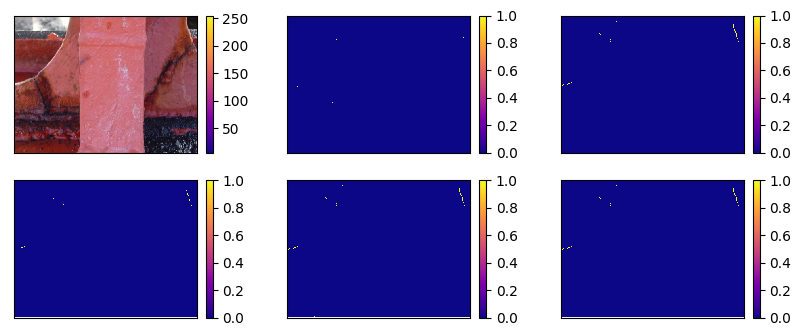

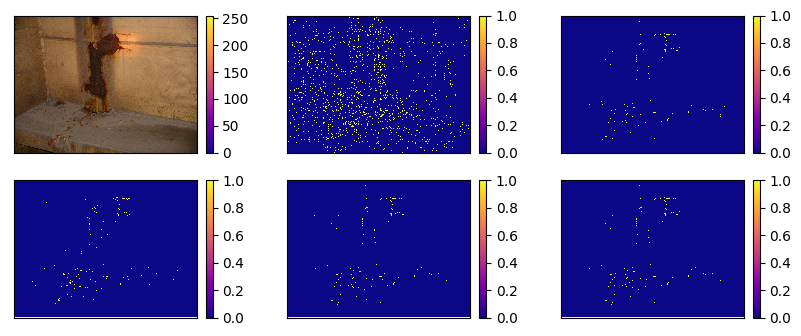

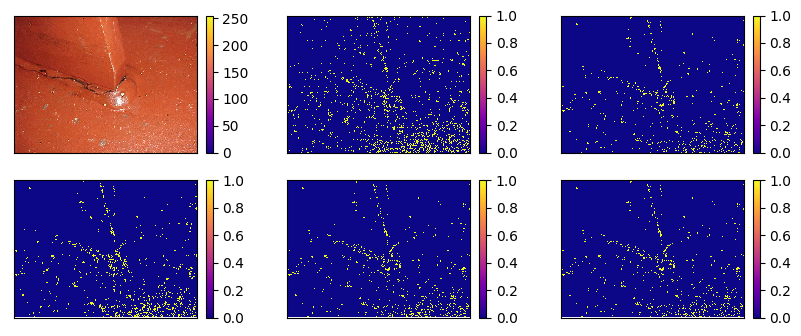

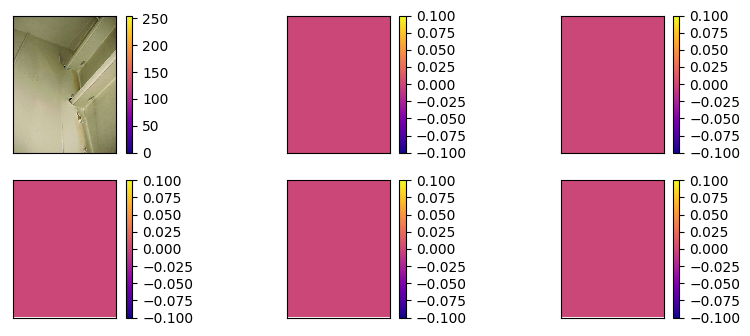

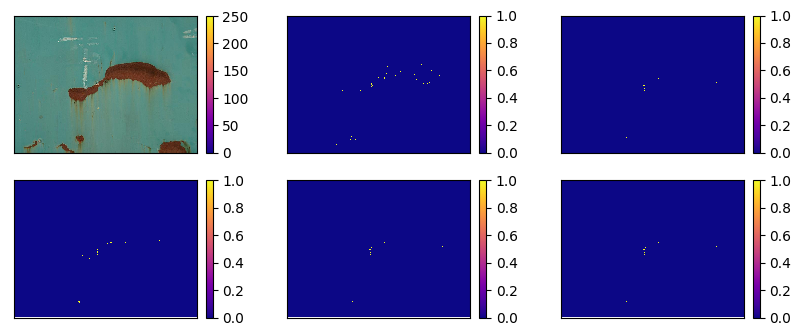

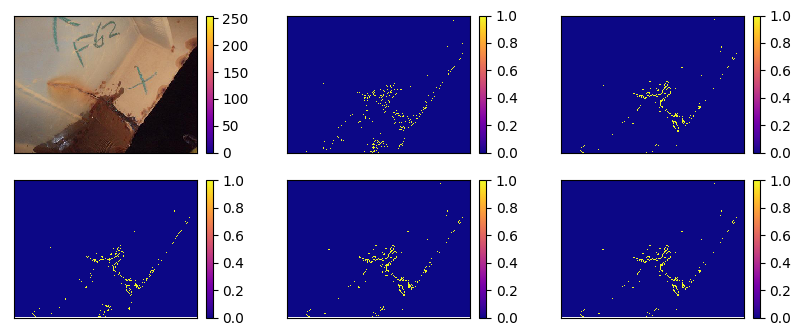

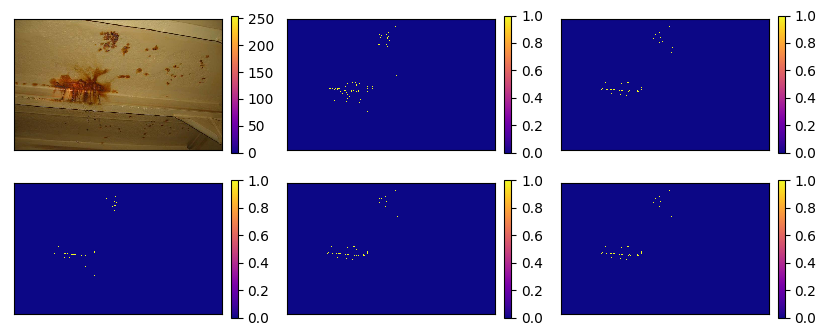

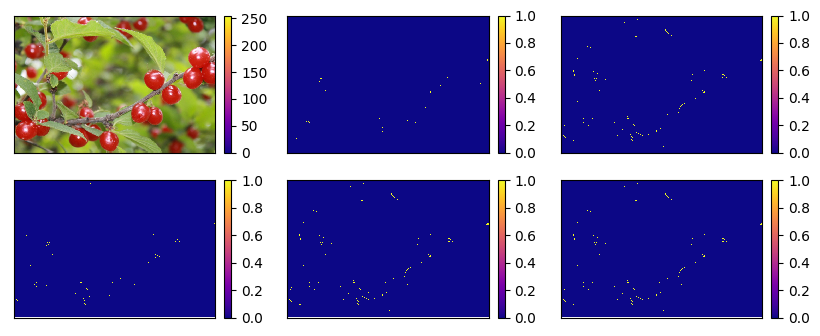

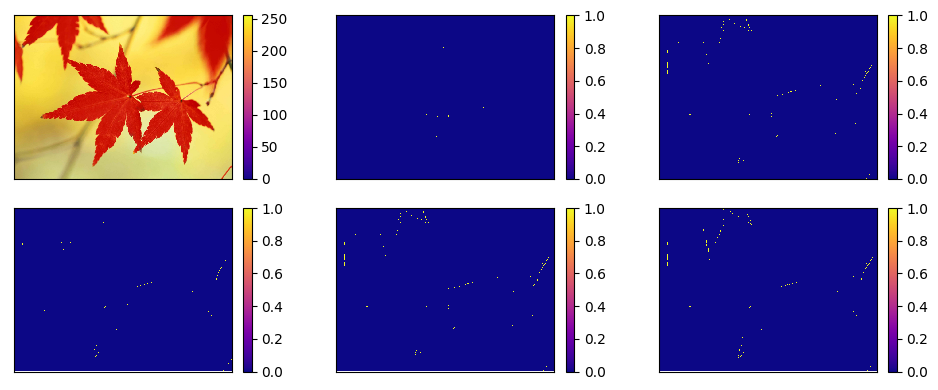

In [100]:
# Edge detection

# calculates edge magnitudes
def edgeMag(im,thr):
    #gray = toGray(getMasked(img,mask))
    #gmask = grayMask(mask)
    
    gray = im.gray
    gmask = im.gmask
    
    edgeMags = [filters.laplace(gray,ksize=3,mask=gmask),filters.prewitt(gray,gmask),filters.roberts(gray,gmask),filters.scharr(gray,gmask),filters.sobel(gray,gmask)]
    edges = []
    for ed in edgeMags:
        edges.append(ed > thr)
    
    return edges,edgeMags

#
def plotEdges(im,thr,useMask=True):
    if useMask: mask = im.mask
    else: mask = emptyMask(im.rgb)
    
    edges = edgeMag(im,thr)[0]
    edges.insert(0,im.rgb)
    
    fig,axes = plt.subplots(2,3,figsize=(10,4))
    for ax,edge in zip(axes.flat,edges):
        ims = ax.imshow(edge)
        fig.colorbar(ims,ax=ax,fraction=0.046,pad=0.04)
        ax.set_xticks([]); ax.set_yticks([])
        
#
def plotAllEdges(imgs,thr,useMask=True):
    for im in imgs:
        plotEdges(im,thr,useMask=useMask)
        

thr = 0.1
#pos = [im for im in clf.pos]
#neg = [im for im in clf.neg]
test = [im for im in clf.test]

#plotAllEdges(pos,thr) 
#plotAllEdges(neg,thr)
plotAllEdges(test,thr)

plt.tight_layout()
plt.show()

422
395
755
409
1
102
74
213
77


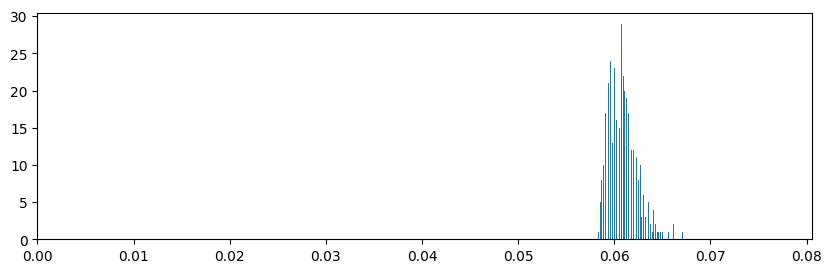

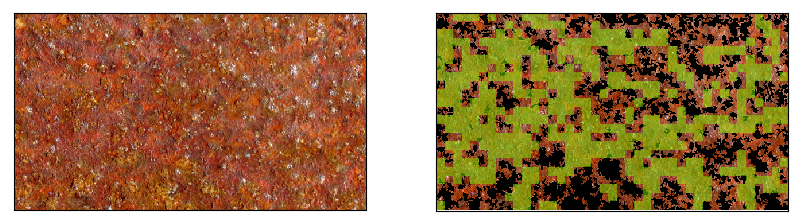

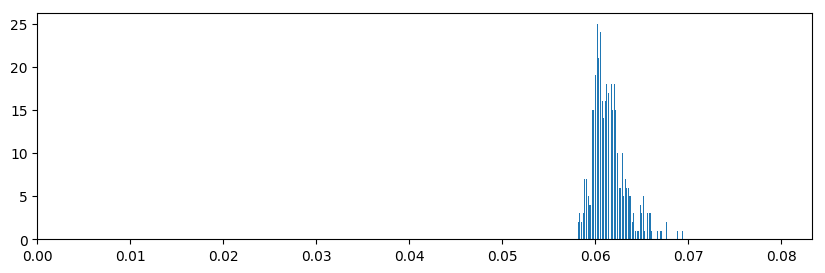

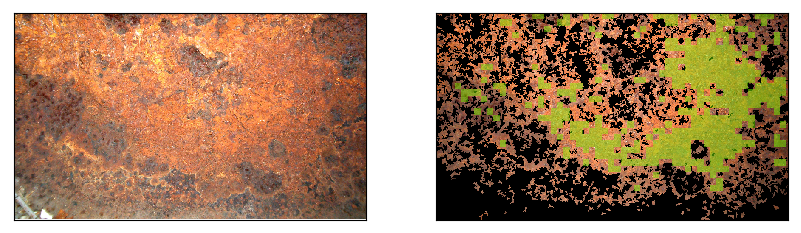

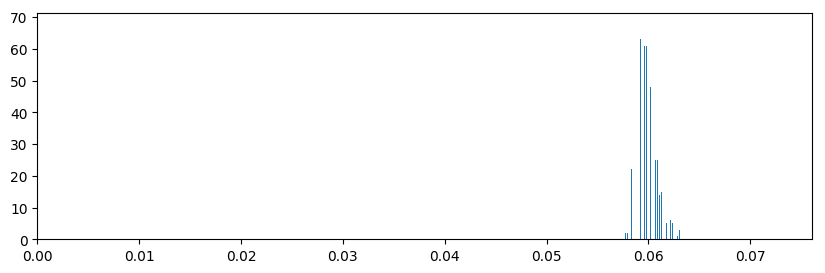

...

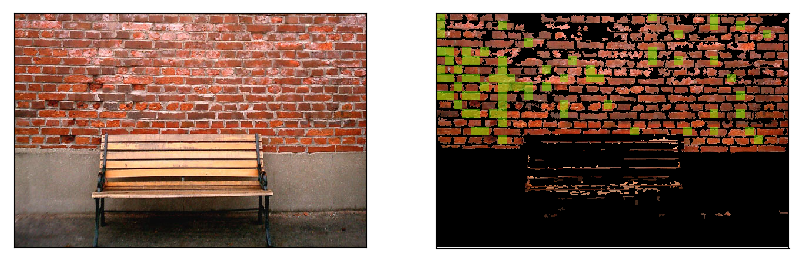

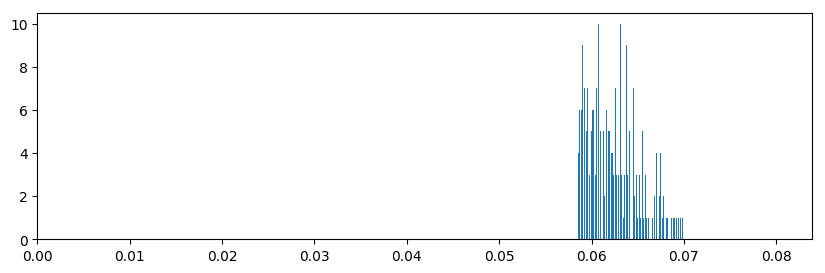

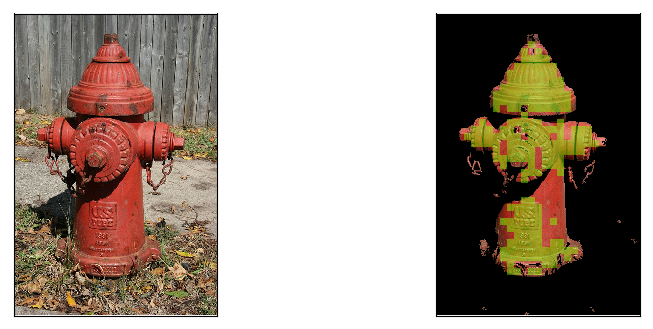

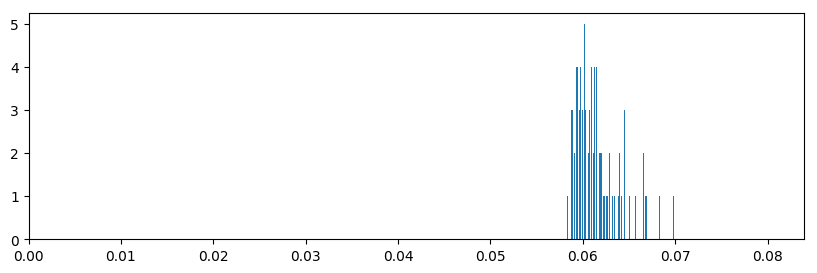

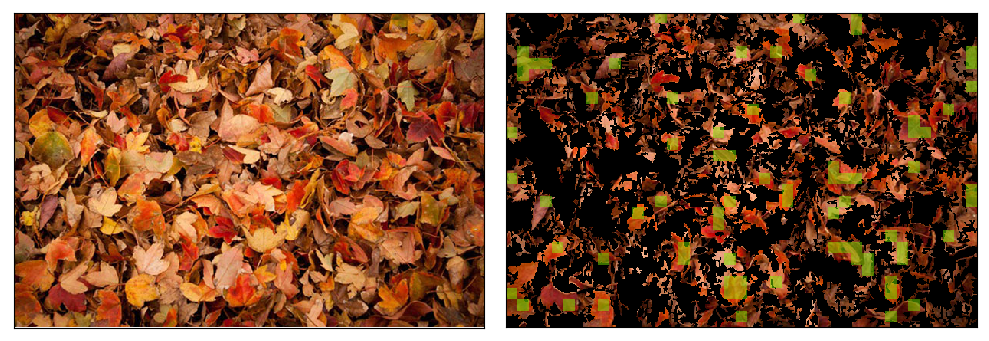

In [88]:
#

def allEnergiesGLCM(img,d,thr,dist,thrE):
    redBlocks,redInd = getRedBlocks(img,getRed(img),d,thr)
    energies = []; keepBlocks = []; keepInd = []
    
    for i in range(len(redBlocks)):
        if redBlocks[i].shape[0] == redBlocks[i].shape[1]:
            en = glcmEnergy(redBlocks[i],dist=dist)
            if en < thrE:
                energies.append(en)
                keepBlocks.append(redBlocks[i]); keepInd.append(redInd[i])
            
    print(len(keepBlocks))
    return np.asarray(energies),keepBlocks,keepInd

#
def energyHistGLCM(img,d,thr,dist,thrE):
    energies,redBlocks,redInd = allEnergiesGLCM(img,d,thr,dist,thrE)
    
    if energies.size == 0:
        return energies,redBlocks,redInd
    
    fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(10,3))
    his,center,wid = hist(energies,nbins=100)
    ax.bar(center,his,width=wid)
    ax.set_xlim([0,1.2*np.amax(energies)])
    
    return energies,redBlocks,redInd

def allEnergyHistGLCM(imgs,d,thr,dist,thrE):

    for im in imgs:
        energies,redBlocks,redInd = energyHistGLCM(im,d,thr,dist,thrE)
        masked = getMasked(im,getRed(im))
        if energies.size > 0:
            drawn = drawBlocksColorCoded(masked,redInd,d,0.5*energies / np.amax(energies))
        else:
            drawn = masked
        display(im,drawn)

    return 

pos = loadAll("positive")
neg = loadAll("negative")
test = loadAll("test")
#test2 = loadAll("test2")

d = 15
thr = 0.8
dist = 5
thrE = 0.07

allEnergyHistGLCM(pos,d,thr,dist,thrE)
allEnergyHistGLCM(neg,d,thr,dist,thrE)

plt.tight_layout()
plt.show()

In [72]:
# Modify files

path = "C:/Users/bsz217/Desktop/project/data/"
direc = "new"
#path += direc

for name in os.listdir(path):
    splitext = os.path.splitext(name)
    if splitext[1].strip(".").lower() == "jpg":
        os.rename(os.path.join(path,name),os.path.join(path,splitext[0]+"_0.jpg"))